In [1]:
import pandas as pd
import matplotlib
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import networkx as nx
from scipy.stats import pearsonr
from statsmodels.stats.multitest import multipletests
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from yellowbrick.cluster import KElbowVisualizer
from sklearn.neighbors import NearestNeighbors
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score



from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score

In [2]:
dataset = pd.read_excel('/content/marketing_campaign1.xlsx')
dataset.head()

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0


## EDA

In [3]:
dataset.shape

(2240, 29)

In [4]:
col = dataset.columns

In [5]:
col

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [6]:
dataset.dtypes

ID                              int64
Year_Birth                      int64
Education                      object
Marital_Status                 object
Income                        float64
Kidhome                         int64
Teenhome                        int64
Dt_Customer            datetime64[ns]
Recency                         int64
MntWines                        int64
MntFruits                       int64
MntMeatProducts                 int64
MntFishProducts                 int64
MntSweetProducts                int64
MntGoldProds                    int64
NumDealsPurchases               int64
NumWebPurchases                 int64
NumCatalogPurchases             int64
NumStorePurchases               int64
NumWebVisitsMonth               int64
AcceptedCmp3                    int64
AcceptedCmp4                    int64
AcceptedCmp5                    int64
AcceptedCmp1                    int64
AcceptedCmp2                    int64
Complain                        int64
Z_CostContac

In [7]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   ID                   2240 non-null   int64         
 1   Year_Birth           2240 non-null   int64         
 2   Education            2240 non-null   object        
 3   Marital_Status       2240 non-null   object        
 4   Income               2216 non-null   float64       
 5   Kidhome              2240 non-null   int64         
 6   Teenhome             2240 non-null   int64         
 7   Dt_Customer          2240 non-null   datetime64[ns]
 8   Recency              2240 non-null   int64         
 9   MntWines             2240 non-null   int64         
 10  MntFruits            2240 non-null   int64         
 11  MntMeatProducts      2240 non-null   int64         
 12  MntFishProducts      2240 non-null   int64         
 13  MntSweetProducts     2240 non-nul

In [8]:
dataset.describe(include='number').T

,count,mean,std,min,25%,50%,75%,max
ID,2240.0,5592.159821,3246.662198,0.0,2828.25,5458.5,8427.75,11191.0
Year_Birth,2240.0,1968.805804,11.984069,1893.0,1959.00,1970.0,1977.00,1996.0
Income,2216.0,52247.251354,25173.076661,1730.0,35303.00,51381.5,68522.00,666666.0
Kidhome,2240.0,0.444196,0.538398,0.0,0.00,0.0,1.00,2.0
Teenhome,2240.0,0.506250,0.544538,0.0,0.00,0.0,1.00,2.0
Recency,2240.0,49.109375,28.962453,0.0,24.00,49.0,74.00,99.0
MntWines,2240.0,303.935714,336.597393,0.0,23.75,173.5,504.25,1493.0
MntFruits,2240.0,26.302232,39.773434,0.0,1.00,8.0,33.00,199.0
MntMeatProducts,2240.0,166.950000,225.715373,0.0,16.00,67.0,232.00,1725.0
MntFishProducts,2240.0,37.525446,54.628979,0.0,3.00,12.0,50.00,259.0


In [9]:
dataset.nunique()

ID                     2240
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             663
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         558
MntFishProducts         182
MntSweetProducts        177
MntGoldProds            213
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Z_CostContact             1
Z_Revenue                 1
Response                  2
dtype: int64

In [10]:
dataset.duplicated().any()

False

In [11]:
dataset.isnull().any()

ID                     False
Year_Birth             False
Education              False
Marital_Status         False
Income                  True
Kidhome                False
Teenhome               False
Dt_Customer            False
Recency                False
MntWines               False
MntFruits              False
MntMeatProducts        False
MntFishProducts        False
MntSweetProducts       False
MntGoldProds           False
NumDealsPurchases      False
NumWebPurchases        False
NumCatalogPurchases    False
NumStorePurchases      False
NumWebVisitsMonth      False
AcceptedCmp3           False
AcceptedCmp4           False
AcceptedCmp5           False
AcceptedCmp1           False
AcceptedCmp2           False
Complain               False
Z_CostContact          False
Z_Revenue              False
Response               False
dtype: bool

In [12]:
# Separating Numeric columns
numeric_cols = dataset.select_dtypes(include=['number'])
numeric_cols

,ID,Year_Birth,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,58138.0,0,0,58,635,88,546,172,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,46344.0,1,1,38,11,1,6,2,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,71613.0,0,0,26,426,49,127,111,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,26646.0,1,0,26,11,4,20,10,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,58293.0,1,0,94,173,43,118,46,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,61223.0,0,1,46,709,43,182,42,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,64014.0,2,1,56,406,0,30,0,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,56981.0,0,0,91,908,48,217,32,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,69245.0,0,1,8,428,30,214,80,...,3,0,0,0,0,0,0,3,11,0


<Axes: >

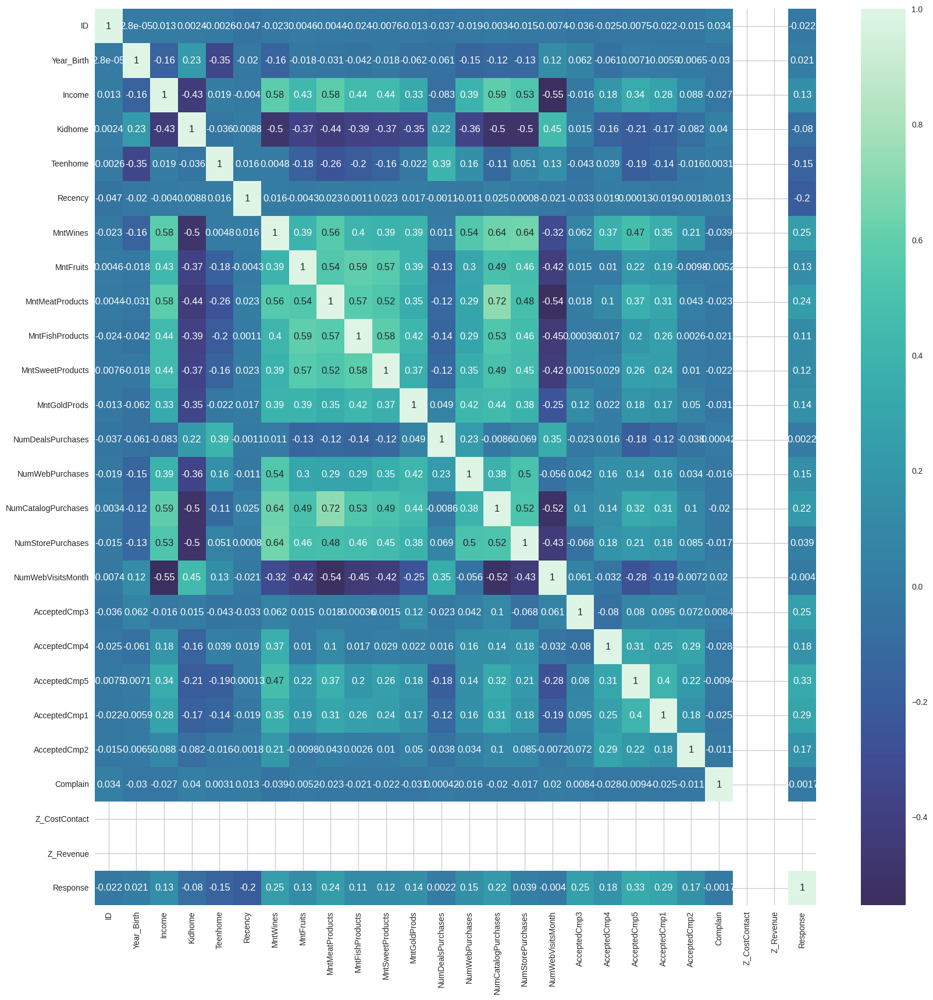

In [13]:
corr_matrix = numeric_cols.corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr_matrix, annot = True, cmap = 'mako', center = 0)

## Checking for Outliers using the Box plots for all the columns

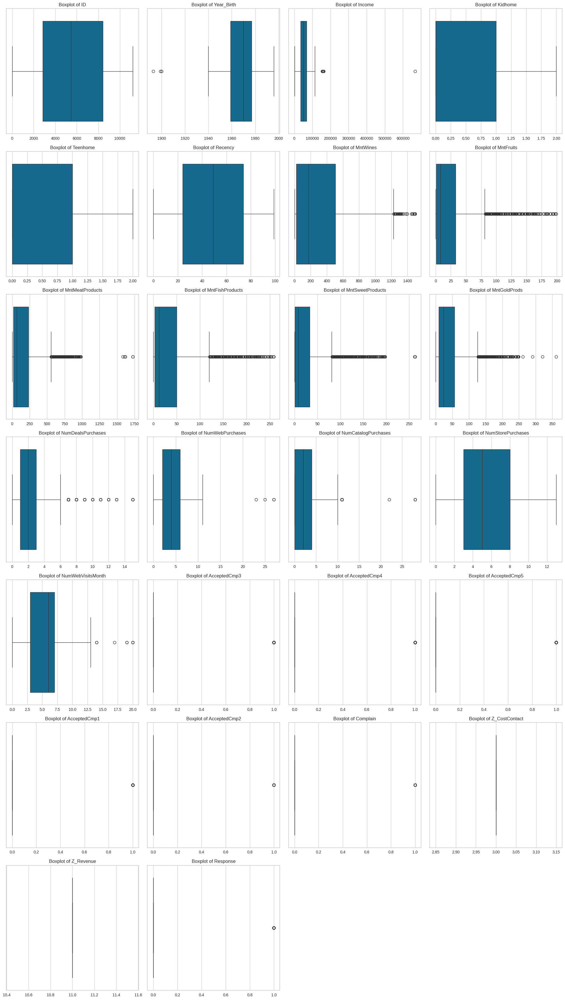

In [14]:
#BOX PLOTS FOR ALL THE NUMERIC COLUMNS
plt.figure(figsize=(20, 40))

for i, col in enumerate(numeric_cols.columns):
    plt.subplot(8, 4, i+1)
    sns.boxplot(x=numeric_cols[col])
    plt.title(f'Boxplot of {col}')
    plt.xlabel('')
    plt.ylabel('')
plt.tight_layout()
plt.show()

## Checking for the Distribution of data in all the numerical columns using Histograms

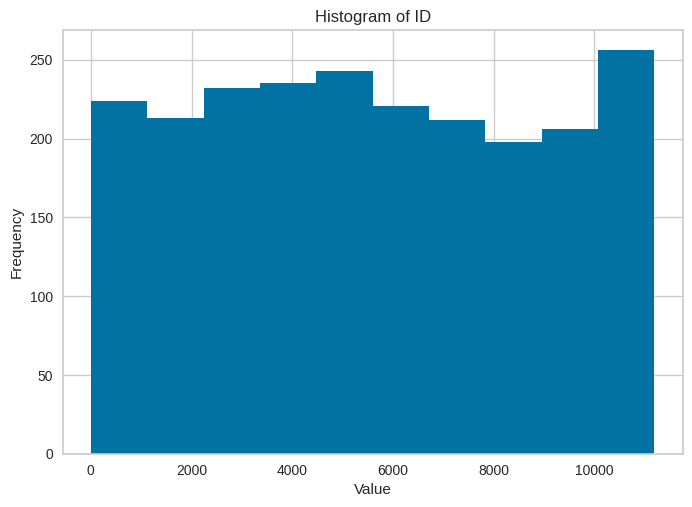

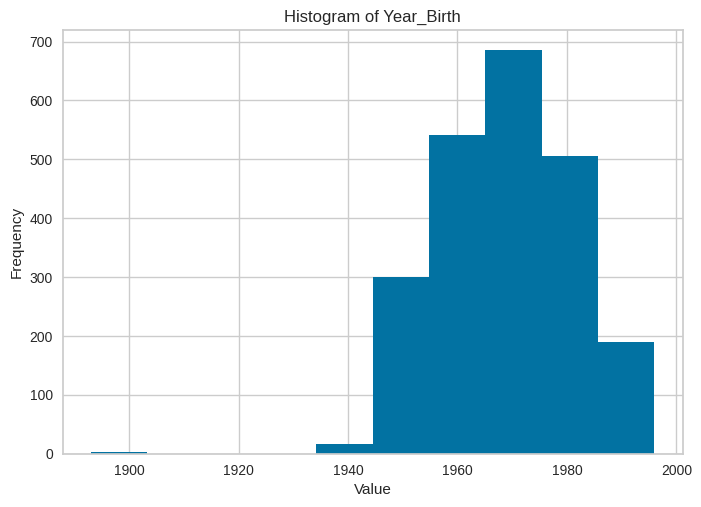

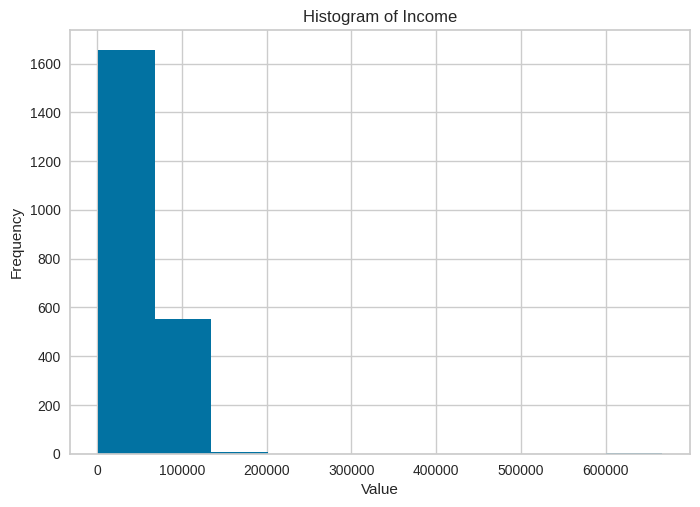

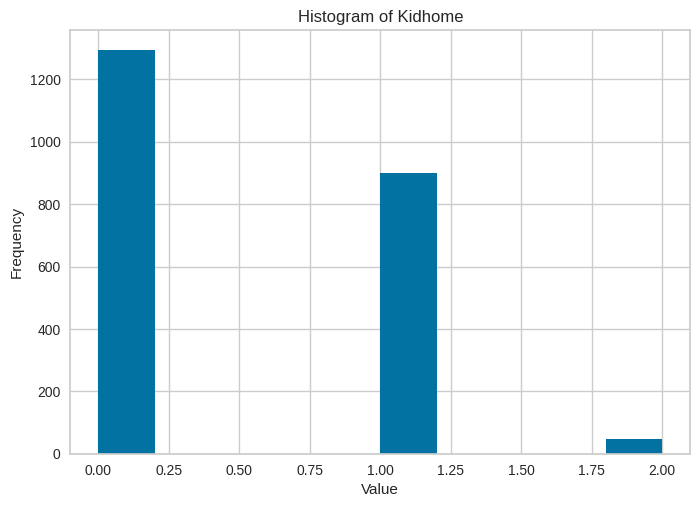

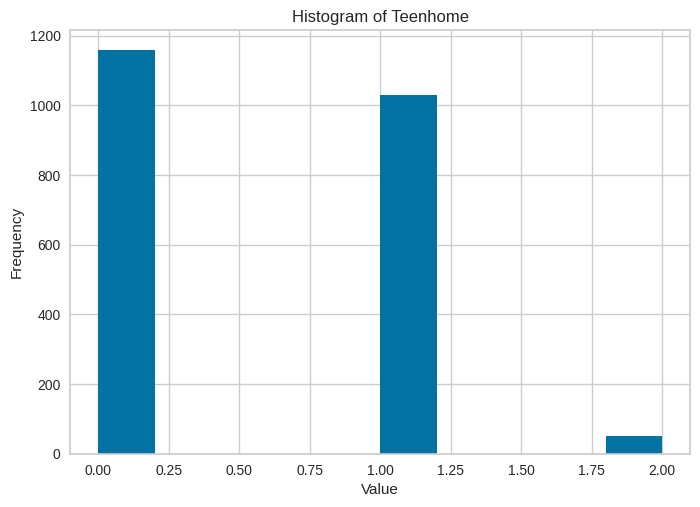

...

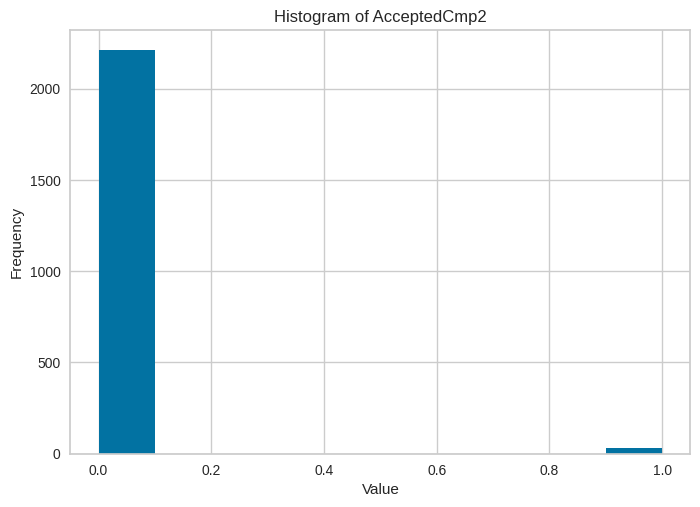

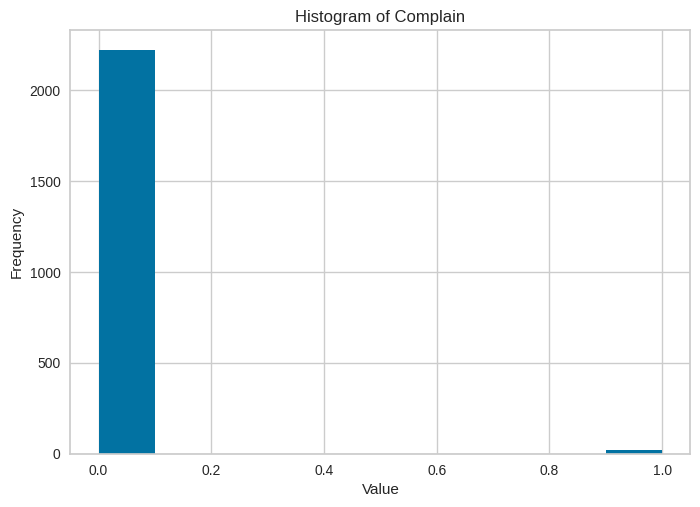

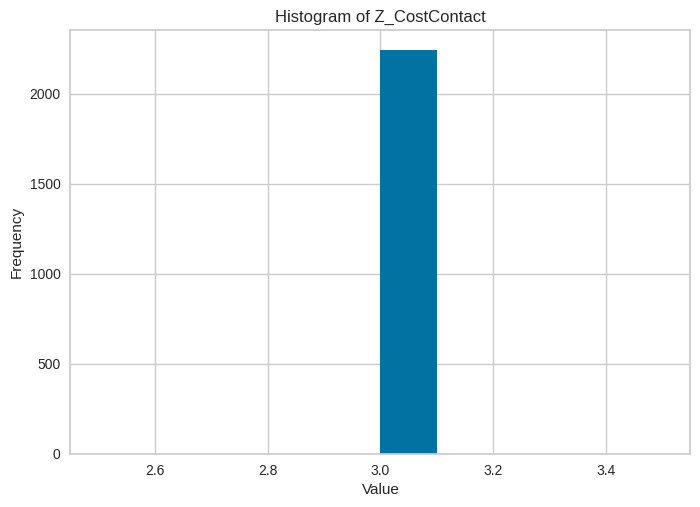

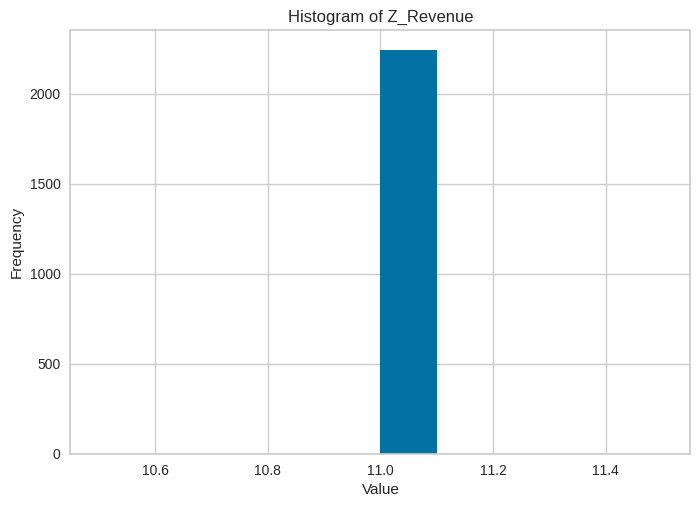

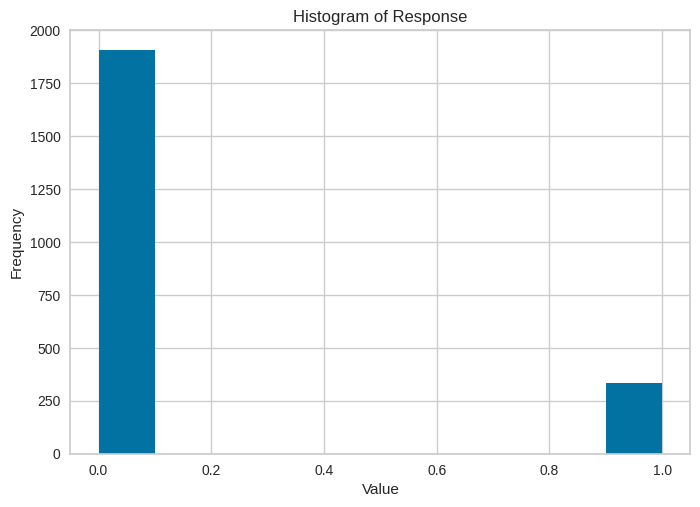

In [15]:
# Create histograms for all  numeric columns
for i, col in enumerate(numeric_cols.columns):

    plt.hist(numeric_cols[col], bins=10)
    plt.title(f'Histogram of {col}')
    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

## FEATURE ENGINEERING

As seen in the heat map the columns Z_CostContact	and Z_Revenue are not contributing anything to the data.So they will be dropped

In [16]:
dataset.drop(columns=['Z_CostContact', 'Z_Revenue'], inplace=True)

In [17]:
data = dataset.copy()

In [18]:
data.head(3)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,10,4,7,0,0,0,0,0,0,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,1,2,5,0,0,0,0,0,0,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,2,10,4,0,0,0,0,0,0,0


## 1) CREATING A NEW COLUMN CALLED AGE USING THE YEAR_BIRTH COLUMN

In [19]:
data['Year_Birth'] = pd.to_datetime(data['Year_Birth'], format='%Y')
now = pd.Timestamp('now')
data['Year_Birth'] = data['Year_Birth'].where(data['Year_Birth'] < now, data['Year_Birth'] -  np.timedelta64(100, 'Y'))


In [20]:
data['age'] = (now - data['Year_Birth']).dt.days / 365

In [21]:
data['age'] = data['age'].astype(int)

In [22]:
data['age']

0       67
1       70
2       59
3       40
4       43
        ..
2235    57
2236    78
2237    43
2238    68
2239    70
Name: age, Length: 2240, dtype: int64

Analysis on Year_Birth Variable

In [23]:
#checking number of unique categories present in the 'Year_Birth'
print("Unique categories present in the Year_Birth:")
print(data["Year_Birth"].value_counts())

Unique categories present in the Year_Birth:
Year_Birth
1976-01-01    89
1971-01-01    87
1975-01-01    83
1972-01-01    79
1978-01-01    77
1970-01-01    77
1973-01-01    74
1965-01-01    74
1969-01-01    71
1974-01-01    69
1956-01-01    55
1958-01-01    53
1979-01-01    53
1952-01-01    52
1977-01-01    52
1968-01-01    51
1959-01-01    51
1966-01-01    50
1954-01-01    50
1955-01-01    49
1960-01-01    49
1982-01-01    45
1963-01-01    45
1967-01-01    44
1962-01-01    44
1957-01-01    43
1951-01-01    43
1983-01-01    42
1986-01-01    42
1964-01-01    42
1980-01-01    39
1981-01-01    39
1984-01-01    38
1961-01-01    36
1953-01-01    35
1985-01-01    32
1989-01-01    30
1949-01-01    30
1950-01-01    29
1988-01-01    29
1987-01-01    27
1948-01-01    21
1990-01-01    18
1946-01-01    16
1947-01-01    16
1991-01-01    15
1992-01-01    13
1945-01-01     8
1943-01-01     7
1944-01-01     7
1993-01-01     5
1995-01-01     5
1994-01-01     3
1996-01-01     2
1899-01-01     1
1941-01-0

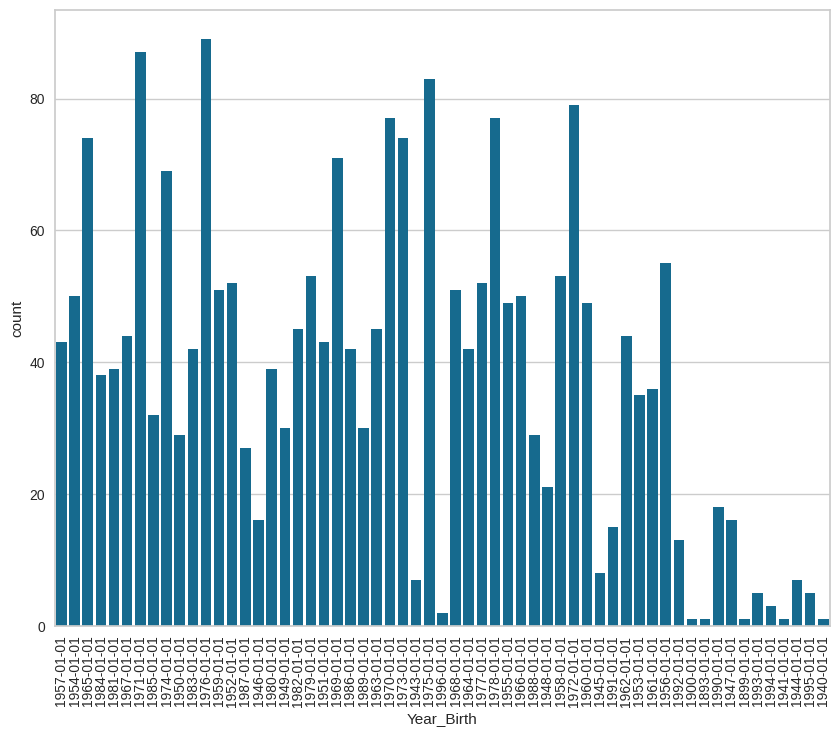

In [24]:
plt.figure(figsize=(10, 8))
sns.countplot(x=data['Year_Birth'], data=data)
plt.xticks(rotation=90)
plt.show()

## 2)Analysis on Age Column

In [25]:
#checking number of unique categories present in the 'Year_Birth'
print("Unique categories present in age column:")
print(data['age'].value_counts())

Unique categories present in age column:
age
48     89
53     87
49     83
52     79
46     77
54     77
51     74
59     74
55     71
50     69
68     55
66     53
45     53
72     52
47     52
56     51
65     51
58     50
70     50
69     49
64     49
42     45
61     45
57     44
62     44
67     43
73     43
41     42
38     42
60     42
44     39
43     39
40     38
63     36
71     35
39     32
35     30
75     30
74     29
36     29
37     27
76     21
34     18
78     16
77     16
33     15
32     13
79      8
81      7
80      7
31      5
29      5
30      3
28      2
125     1
83      1
131     1
124     1
84      1
Name: count, dtype: int64


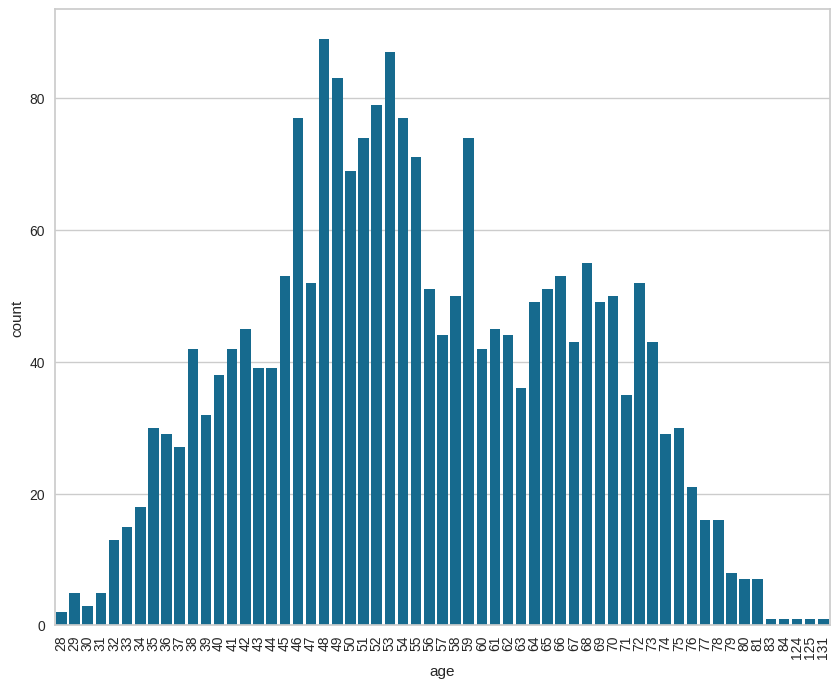

In [26]:
plt.figure(figsize=(10, 8))
sns.countplot(x=data['age'], data=data)
plt.xticks(rotation=90)
plt.show()

Most of the age groups are between 40 years and 80 years

## 3) Analysis on the income column

 24 null values in income

since there are some missing values in income we will check that column and replace missing values with mean or median

Lets check the distribution of income

In [27]:
data['Income'].isnull().any()

True

In [28]:
data['Income'].isnull().sum()

24

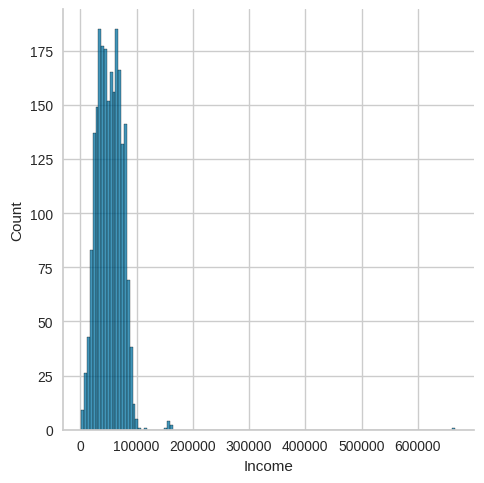

In [29]:
sns.displot(data['Income'])
plt.show()

Here the distribution of data is left skewed ie: it is not evenly distributed so replacing the missing values with median

In [30]:
#Displaying the Null values in the income column
data[pd.isnull(data).any(axis=1)]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,age
10,1994,1983-01-01,Graduation,Married,NaN,1,0,2013-11-15,11,5,...,2,7,0,0,0,0,0,0,0,41
27,5255,1986-01-01,Graduation,Single,NaN,1,0,2013-02-20,19,5,...,0,1,0,0,0,0,0,0,0,38
43,7281,1959-01-01,PhD,Single,NaN,0,0,2013-11-05,80,81,...,4,2,0,0,0,0,0,0,0,65
48,7244,1951-01-01,Graduation,Single,NaN,2,1,2014-01-01,96,48,...,4,6,0,0,0,0,0,0,0,73
58,8557,1982-01-01,Graduation,Single,NaN,1,0,2013-06-17,57,11,...,3,6,0,0,0,0,0,0,0,42
71,10629,1973-01-01,2n Cycle,Married,NaN,1,0,2012-09-14,25,25,...,3,8,0,0,0,0,0,0,0,51
90,8996,1957-01-01,PhD,Married,NaN,2,1,2012-11-19,4,230,...,8,9,0,0,0,0,0,0,0,67
91,9235,1957-01-01,Graduation,Single,NaN,1,1,2014-05-27,45,7,...,2,7,0,0,0,0,0,0,0,67
92,5798,1973-01-01,Master,Together,NaN,0,0,2013-11-23,87,445,...,8,1,0,0,0,0,0,0,0,51
128,8268,1961-01-01,PhD,Married,NaN,0,1,2013-07-11,23,352,...,7,6,0,0,0,0,0,0,0,63


In [31]:
#Filling the null values with Median
data['Income']=data['Income'].fillna(data['Income'].median())

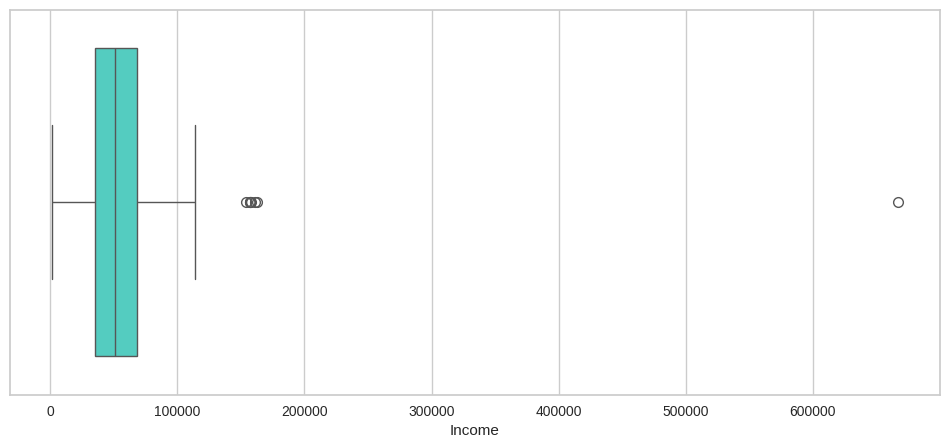

In [32]:
plt.figure(figsize=(12, 5))
sns.boxplot(x=data['Income'], color='turquoise')
plt.show()

Most of the peoples income is between 40k and 80 and there are some outliers as well

## 4) Analysis on Education Variable

In [33]:
data['Education'].unique()

array(['Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'], dtype=object)

Changing the category into UG, Graduate,PG and PhD

In [34]:
#CHANGING THE CATOGORY INTO UG AND PG ONLY.....
data['Education']=data['Education'].replace({'Master':'PostGraduate','Basic':'UnderGraduate','2n Cycle':'PostGraduate','Graduation':'Graduate'})


In [35]:
data['Education'].unique()

array(['Graduate', 'PhD', 'PostGraduate', 'UnderGraduate'], dtype=object)

<ipython-input-36-b6d9cd12392e>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data,x='Education',palette='twilight')


<Axes: xlabel='Education', ylabel='count'>

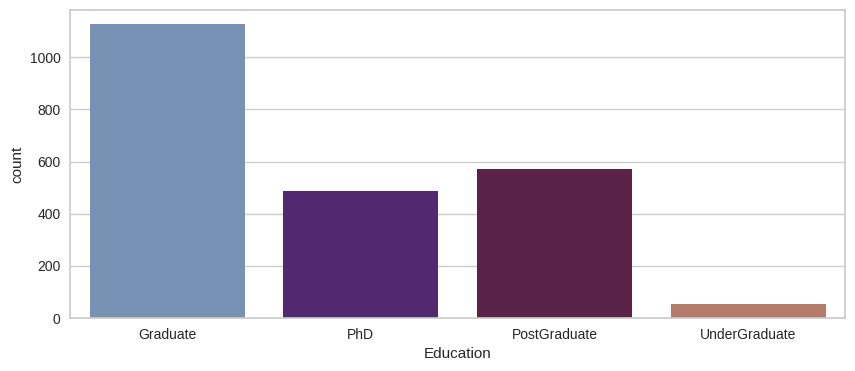

In [36]:
plt.figure(figsize=(10,4))
sns.countplot(data=data,x='Education',palette='twilight')

The data consists of more number of graduates and very few undergraduates.

<Axes: xlabel='Education', ylabel='count'>

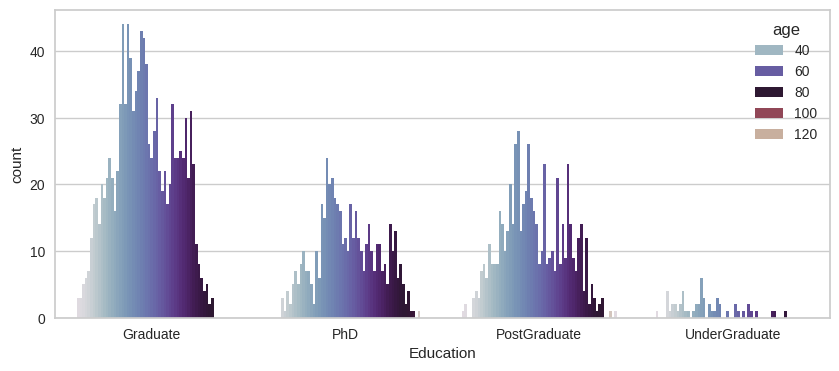

In [37]:
plt.figure(figsize=(10,4))
sns.countplot(data=data,x='Education',hue = 'age',palette='twilight')

<Axes: xlabel='Education', ylabel='count'>

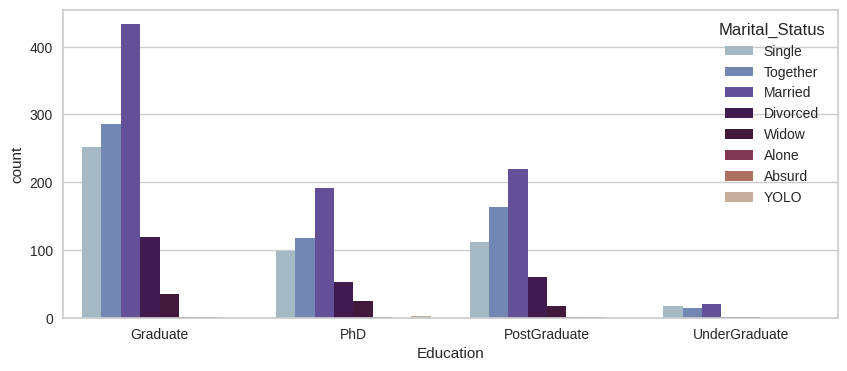

In [38]:
plt.figure(figsize=(10,4))
sns.countplot(data=data,x='Education',hue = 'Marital_Status',palette='twilight')

Most of the graduates are Married.

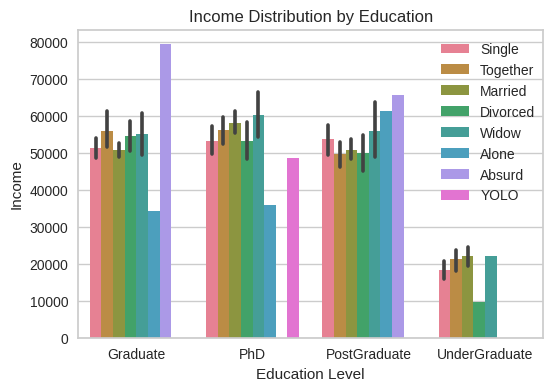

In [39]:
plt.figure(figsize=(6,4),dpi=100)
sns.barplot(data=data, x='Education', y='Income',
            estimator=np.mean,hue='Marital_Status')
plt.title('Income Distribution by Education')
plt.xlabel('Education Level')
plt.ylabel('Income')

plt.legend(bbox_to_anchor=(1.01,1))

Married PhD s have the highest Income and Graduates who have Together status have the highest income

## 5)Analysis on Marital_Status.Variable

In [40]:
data['Marital_Status'].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone',
       'Absurd', 'YOLO'], dtype=object)

Replacing the Conflict values in Marital_Status...

In [41]:
# Replacing some conflict values with Marital Status.
data['Marital_Status']= data['Marital_Status'].replace(['Widow', 'Alone','Absurd', 'YOLO','Divorced'],'Others')
data['Marital_Status']

0         Single
1         Single
2       Together
3       Together
4        Married
          ...   
2235     Married
2236    Together
2237      Others
2238    Together
2239     Married
Name: Marital_Status, Length: 2240, dtype: object

<ipython-input-42-9288f749d742>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=data,x='Marital_Status',palette='twilight')


<Axes: xlabel='Marital_Status', ylabel='count'>

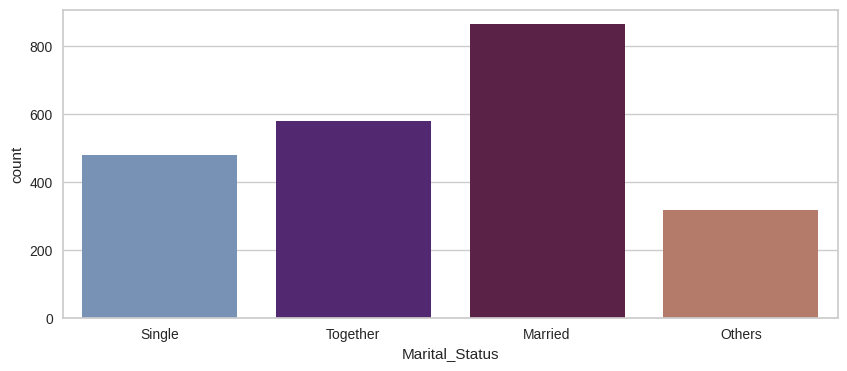

In [42]:
plt.figure(figsize=(10,4))
sns.countplot(data=data,x='Marital_Status',palette='twilight')

Most of them are married whereas the least number is the others

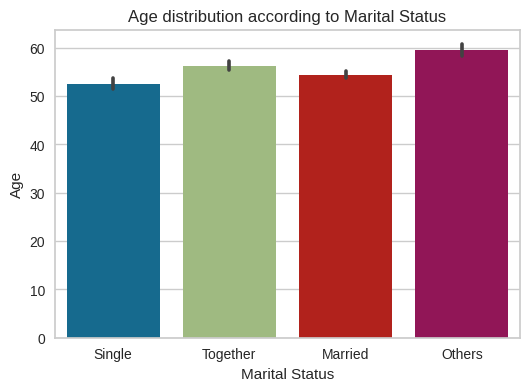

In [43]:
plt.figure(figsize=(6,4),dpi=100)
sns.barplot(data=data, x='Marital_Status', y='age',
            estimator=np.mean,hue='Marital_Status')
plt.title('Age distribution according to Marital Status')
plt.xlabel('Marital Status')
plt.ylabel('Age')

plt.legend(bbox_to_anchor=(1.01,1))

## 6) Analysis On "Kidhome,Teenhome"Variable

In [44]:
data['Teenhome'].unique()

array([0, 1, 2])

In [45]:
data['Kidhome'].unique()

array([0, 1, 2])

Combining teenhome and kidhome to kids

In [46]:
#Combing teenhome and kidhome to kids
data['Kids'] = data['Kidhome'] + data['Teenhome']

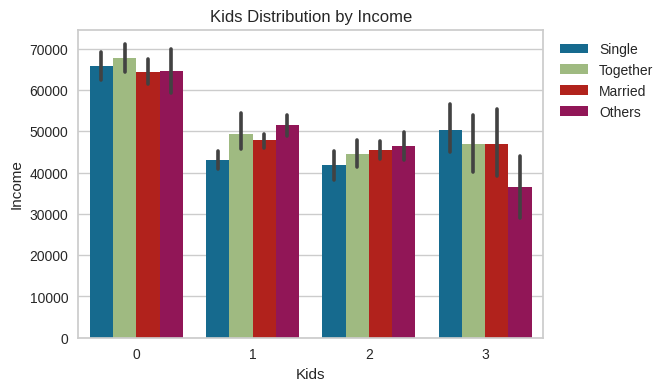

In [47]:
plt.figure(figsize=(6,4),dpi=100)
sns.barplot(data=data, x='Kids', y='Income',
            estimator=np.mean,hue='Marital_Status')
plt.title('Kids Distribution by Income')
plt.xlabel('Kids')
plt.ylabel('Income')

plt.legend(bbox_to_anchor=(1.01,1))

Most of the Highest Income people do not have kids

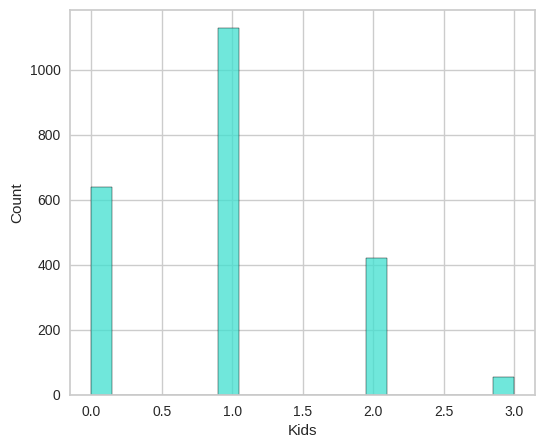

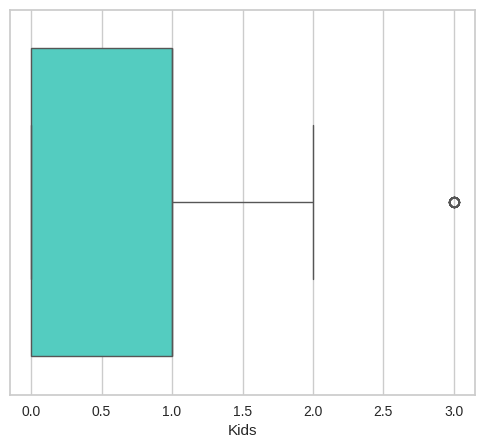

In [48]:
plt.figure(figsize=(6, 5))
sns.histplot(data['Kids'], color='turquoise')
plt.show()

plt.figure(figsize=(6, 5))
sns.boxplot(x=data['Kids'], color='turquoise')
plt.show()

## 7) Analysis On MntWines, MntMeatProducts, MntFishProducts, MntSweetProucts MntGoldProds Variable

In [49]:
data[['MntWines','MntMeatProducts','MntFishProducts','MntFruits','MntSweetProducts','MntGoldProds']].head()

,MntWines,MntMeatProducts,MntFishProducts,MntFruits,MntSweetProducts,MntGoldProds
0,635,546,172,88,88,88
1,11,6,2,1,1,6
2,426,127,111,49,21,42
3,11,20,10,4,3,5
4,173,118,46,43,27,15


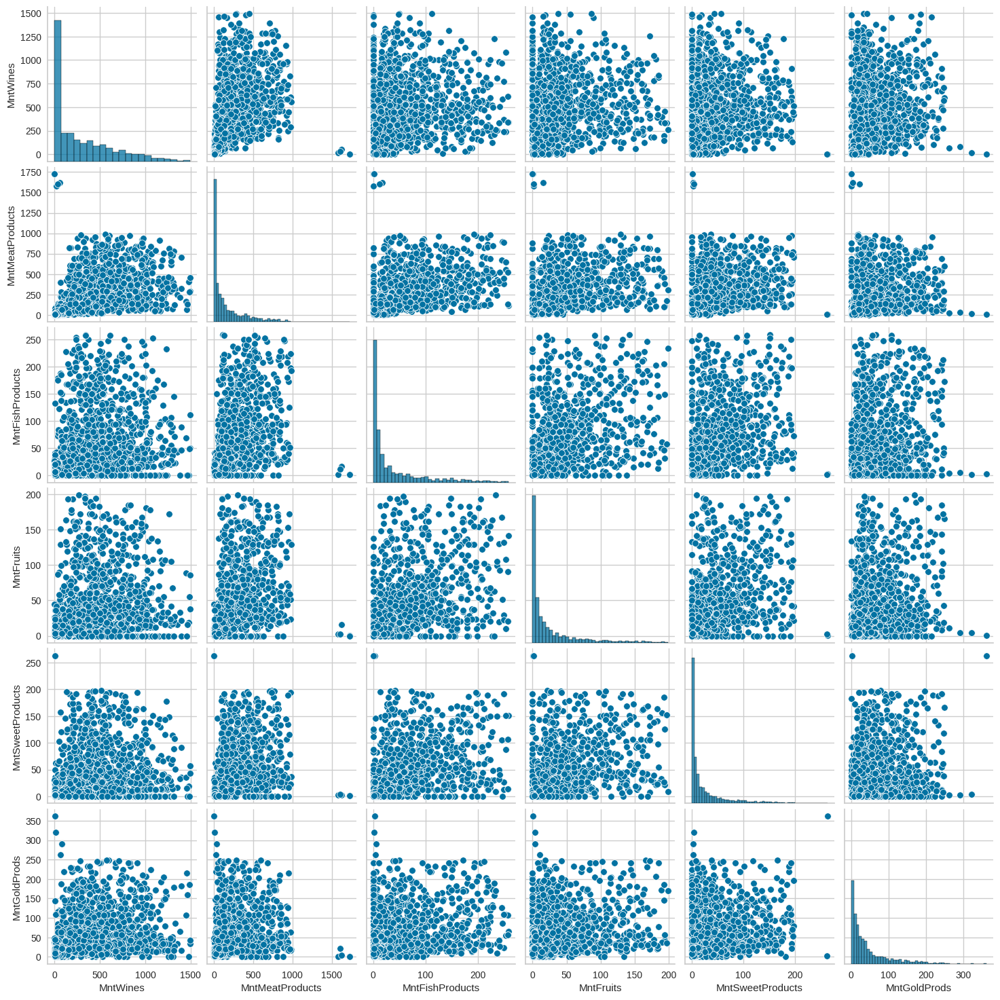

In [50]:
sns.pairplot(data[['MntWines','MntMeatProducts','MntFishProducts','MntFruits','MntSweetProducts','MntGoldProds']])

Combining different columns into a single column to reduce the number of dimensions

In [51]:
#Combining different columns into a single column to reduce the number of dimentions
data['Expenses'] = data['MntWines']+data['MntFruits']+ data['MntMeatProducts']+ data['MntFishProducts']+ data['MntSweetProducts']+data['MntGoldProds']

In [52]:
data.Expenses

0       1617
1         27
2        776
3         53
4        422
        ... 
2235    1341
2236     444
2237    1241
2238     843
2239     172
Name: Expenses, Length: 2240, dtype: int64

<Figure size 800x500 with 0 Axes>

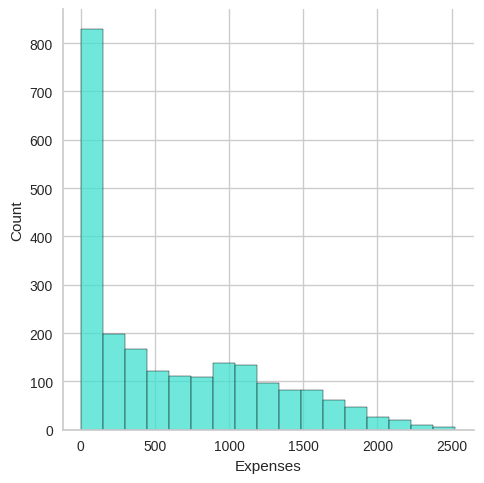

In [53]:
plt.figure(figsize=(8, 5))
sns.displot(data['Expenses'], color='turquoise')
plt.show()

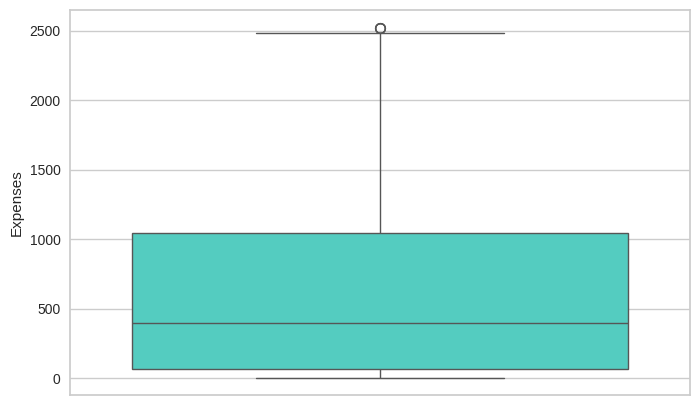

In [54]:
plt.figure(figsize=(8, 5))
sns.boxplot(data=data['Expenses'], color='turquoise')
plt.show()

## 8) Analysis on " AcceptedCmp1"," AcceptedCmp2"," AcceptedCmp3"," AcceptedCmp4"," AcceptedCmp5"Variable

CALCULATING THE TOTAL NUMBER OF CUSTOMER ACCEPTANCES FOR CAMPAIGNS

In [55]:
data['AcceptedCmp1'].unique()

array([0, 1])

In [56]:
data['AcceptedCmp2'].unique()

array([0, 1])

In [57]:
data['AcceptedCmp3'].unique()

array([0, 1])

In [58]:
data['AcceptedCmp4'].unique()

array([0, 1])

In [59]:
data['AcceptedCmp5'].unique()

array([0, 1])

In [60]:
data['TotalAcceptedCmp'] = data['AcceptedCmp1'] + data['AcceptedCmp2'] + data['AcceptedCmp3'] + data['AcceptedCmp4'] + data['AcceptedCmp5']

In [61]:
data['TotalAcceptedCmp']

0       0
1       0
2       0
3       0
4       0
       ..
2235    0
2236    1
2237    1
2238    0
2239    0
Name: TotalAcceptedCmp, Length: 2240, dtype: int64

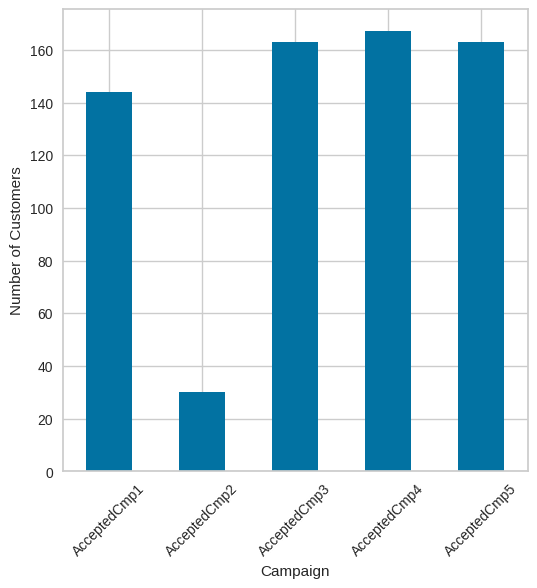

In [62]:
AcceptedCmp = ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5']
AcceptedCmp_count = data[AcceptedCmp].sum()
plt.figure(figsize=(6, 6))
AcceptedCmp_count.plot(kind='bar')
plt.xlabel('Campaign')
plt.ylabel('Number of Customers')
plt.xticks(rotation=45)
plt.show()

## 9)Analysis on NumWebPurchases, NumDealsPurchases, NumCatalogPurchases,  NumStorePurchases, NumWebVisitsMonth Variables.

Calculating Total Number of Purchases made by the customer overall

In [63]:
data['NumWebVisitsMonth'].unique()

array([ 7,  5,  4,  6,  8,  9, 20,  2,  3,  1, 10,  0, 14, 19, 17, 13])

In [64]:
data['NumCatalogPurchases'].unique()

array([10,  1,  2,  0,  3,  4,  6, 28,  9,  5,  8,  7, 11, 22])

In [65]:
data['NumStorePurchases'].unique()

array([ 4,  2, 10,  6,  7,  0,  3,  8,  5, 12,  9, 13, 11,  1])

In [66]:
data['NumTotalPurchases'] = data['NumDealsPurchases']+data['NumCatalogPurchases']+data['NumStorePurchases']+data['NumWebPurchases']

In [67]:
data['NumTotalPurchases'].unique()

array([25,  6, 21,  8, 19, 22, 10,  2,  4, 16, 15,  5, 26,  9, 13, 12, 43,
       17, 20, 14, 27, 11, 18, 28,  7, 24, 29, 23, 32, 30, 37, 31, 33, 35,
       39,  1, 34,  0, 44])

<Figure size 800x500 with 0 Axes>

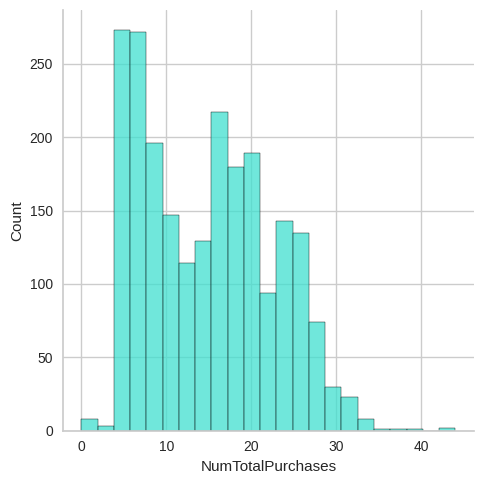

In [68]:
plt.figure(figsize=(8, 5))
sns.displot(data['NumTotalPurchases'], color='turquoise')
plt.show()

In [69]:
data.head(10)

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
0,5524,1957-01-01,Graduate,Single,58138.0,0,0,2012-09-04,58,635,...,0,0,0,0,1,67,0,1617,0,25
1,2174,1954-01-01,Graduate,Single,46344.0,1,1,2014-03-08,38,11,...,0,0,0,0,0,70,2,27,0,6
2,4141,1965-01-01,Graduate,Together,71613.0,0,0,2013-08-21,26,426,...,0,0,0,0,0,59,0,776,0,21
3,6182,1984-01-01,Graduate,Together,26646.0,1,0,2014-02-10,26,11,...,0,0,0,0,0,40,1,53,0,8
4,5324,1981-01-01,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,0,0,0,0,0,43,1,422,0,19
5,7446,1967-01-01,PostGraduate,Together,62513.0,0,1,2013-09-09,16,520,...,0,0,0,0,0,57,1,716,0,22
6,965,1971-01-01,Graduate,Others,55635.0,0,1,2012-11-13,34,235,...,0,0,0,0,0,53,1,590,0,21
7,6177,1985-01-01,PhD,Married,33454.0,1,0,2013-05-08,32,76,...,0,0,0,0,0,39,1,169,0,10
8,4855,1974-01-01,PhD,Together,30351.0,1,0,2013-06-06,19,14,...,0,0,0,0,1,50,1,46,0,6
9,5899,1950-01-01,PhD,Together,5648.0,1,1,2014-03-13,68,28,...,0,0,0,0,0,74,2,49,1,2


In [70]:
data.dtypes

ID                              int64
Year_Birth             datetime64[ns]
Education                      object
Marital_Status                 object
Income                        float64
Kidhome                         int64
Teenhome                        int64
Dt_Customer            datetime64[ns]
Recency                         int64
MntWines                        int64
MntFruits                       int64
MntMeatProducts                 int64
MntFishProducts                 int64
MntSweetProducts                int64
MntGoldProds                    int64
NumDealsPurchases               int64
NumWebPurchases                 int64
NumCatalogPurchases             int64
NumStorePurchases               int64
NumWebVisitsMonth               int64
AcceptedCmp3                    int64
AcceptedCmp4                    int64
AcceptedCmp5                    int64
AcceptedCmp1                    int64
AcceptedCmp2                    int64
Complain                        int64
Response    

DEMOGRAPHIC SEGMENTATION ANALYSIS BASED ON AGE,MARITAL STATUS AND EDUCATION

In [71]:
data[['age','Marital_Status','Education','Income','NumTotalPurchases','Expenses']].head(3)

,age,Marital_Status,Education,Income,NumTotalPurchases,Expenses
0,67,Single,Graduate,58138.0,25,1617
1,70,Single,Graduate,46344.0,6,27
2,59,Together,Graduate,71613.0,21,776


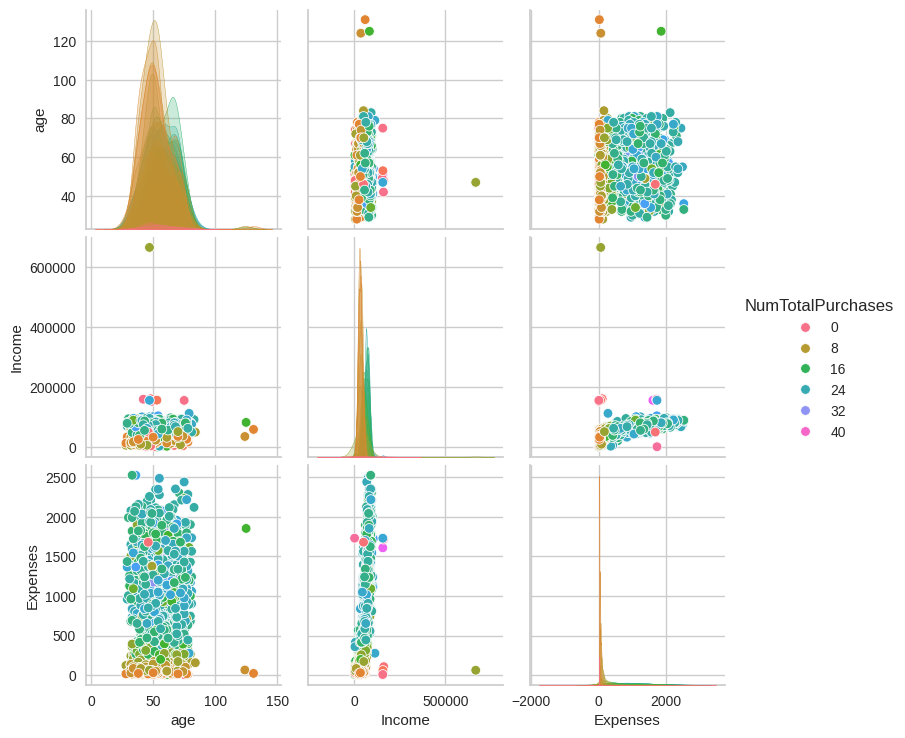

In [72]:
sns.pairplot(data[['age','Marital_Status','Education','Income','NumTotalPurchases','Expenses']], hue="NumTotalPurchases", palette='husl')

<Axes: xlabel='Education', ylabel='count'>

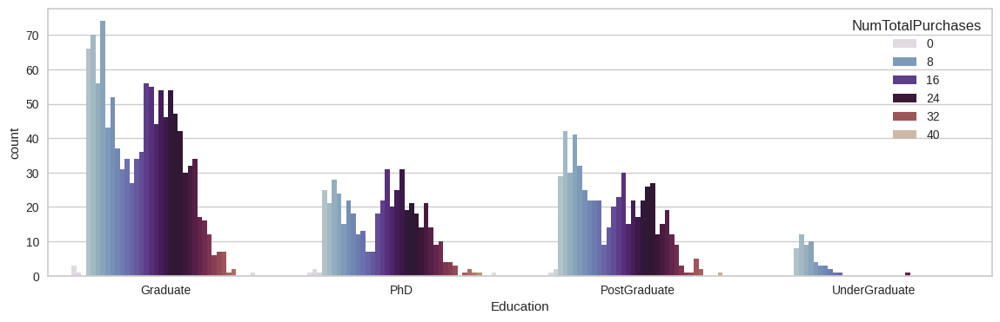

In [73]:
plt.figure(figsize=(14,4))
sns.countplot(data=data[['age','Marital_Status','Education','Income','NumTotalPurchases','Expenses']],x='Education',
              hue='NumTotalPurchases',palette='twilight')

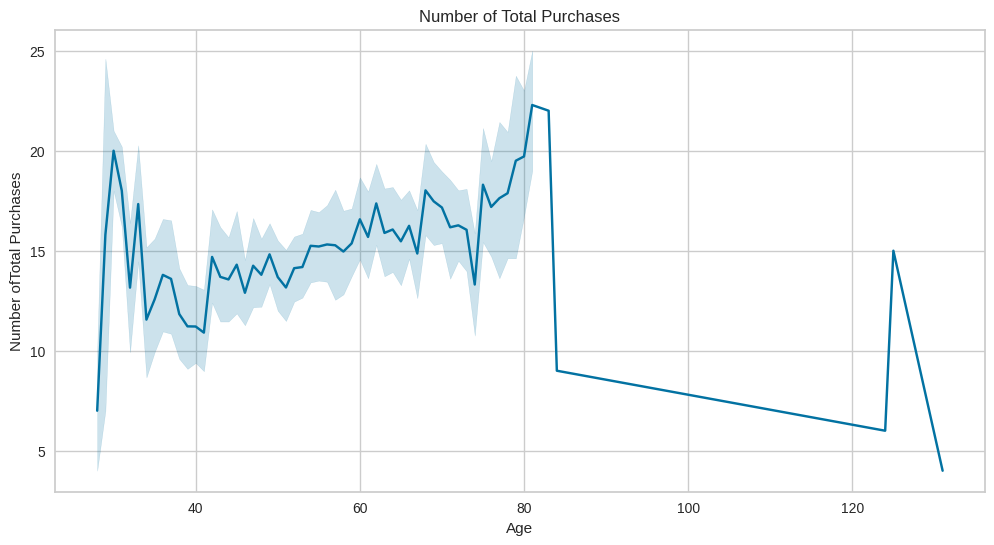

In [74]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=data, x='age', y='NumTotalPurchases')
plt.title('Number of Total Purchases')
plt.xlabel('Age')
plt.ylabel('Number ofTotal Purchases')
plt.show()

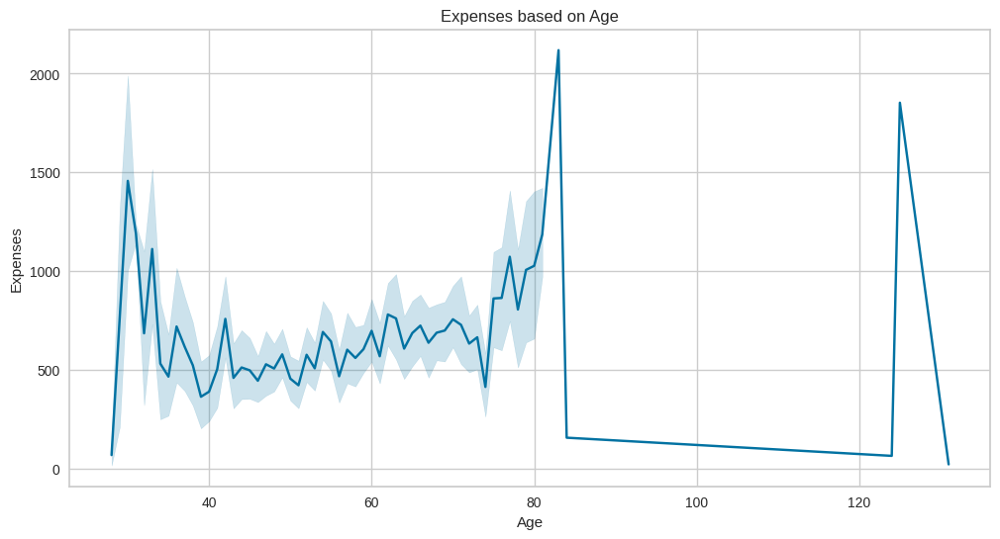

In [75]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=data, x='age', y='Expenses')
plt.title('Expenses based on Age')
plt.xlabel('Age')
plt.ylabel('Expenses')
plt.show()

<Axes: xlabel='Marital_Status', ylabel='count'>

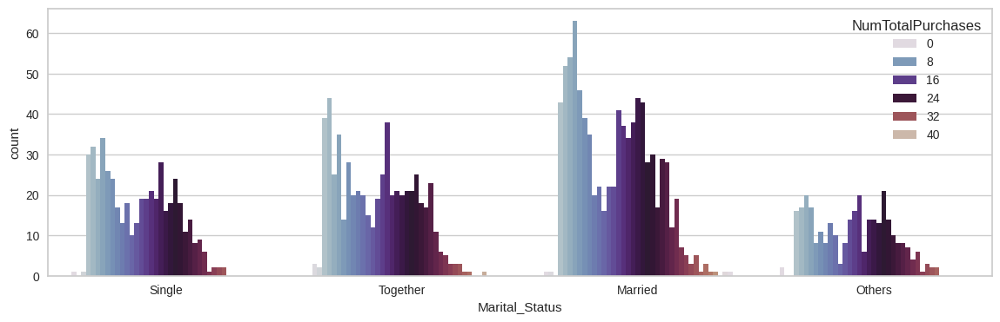

In [76]:
plt.figure(figsize=(14,4))
sns.countplot(data=data,x='Marital_Status',
              hue='NumTotalPurchases',palette='twilight')


10) In the next step create a feature out of "Dt_customer" that indicates the number of days a customer is registered in the firm's database. However, in order to keep it simple, taking this value to the most recent customer in the record. Thus to get the values  check the newest and oldest recorded datas

In [77]:
data["Dt_Customer"]= pd.to_datetime(data["Dt_Customer"])
dates = []
for i in data["Dt_Customer"]:
    i = i.date()
    dates.append(i)
#DATES OF THE NEWEST AND OLDEST RECORDED CUSTOMER
print("The Newest Customer Entrolled Date In The Records:",max(dates))
print("The Oldest Customer Entrolled Date In The Records:",min(dates))

The Newest Customer Entrolled Date In The Records: 2014-06-29
The Oldest Customer Entrolled Date In The Records: 2012-07-30


In [78]:
# Creating a feature "Customer_For"
days = []
d1 = max(dates)  # taking it to be the newest customer, assuming 'dates' is defined elsewhere
for i in dates:
    delta = d1 - i  # Calculating the difference in days between the newest date and each date in the list 'dates'
    days.append(delta)

# Assigning the list 'days' to the 'Customer_For' column
data["Customer_For"] = days

In [79]:
data['Customer_For']

0      663 days
1      113 days
2      312 days
3      139 days
4      161 days
         ...   
2235   381 days
2236    19 days
2237   155 days
2238   156 days
2239   622 days
Name: Customer_For, Length: 2240, dtype: timedelta64[ns]

In [80]:
#based on frequency of purchase...that is recency and how are they purchasing
data[['Recency','NumTotalPurchases','NumWebVisitsMonth','Customer_For']]

,Recency,NumTotalPurchases,NumWebVisitsMonth,Customer_For
0,58,25,7,663 days
1,38,6,5,113 days
2,26,21,4,312 days
3,26,8,6,139 days
4,94,19,5,161 days
...,...,...,...,...
2235,46,18,5,381 days
2236,56,22,7,19 days
2237,91,19,6,155 days
2238,8,23,3,156 days


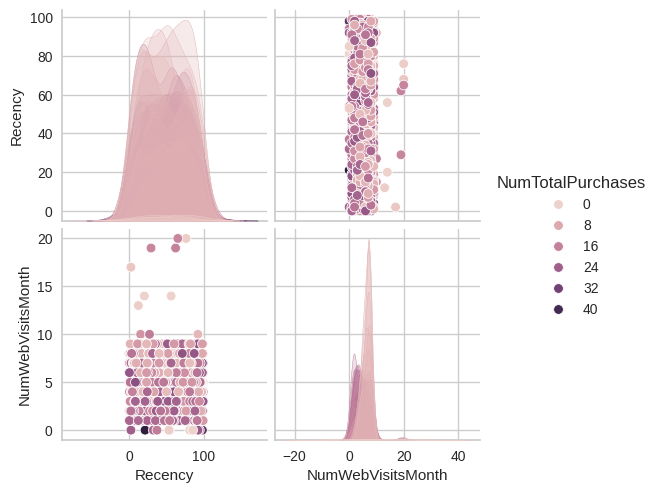

In [81]:
sns.pairplot(data[['Recency','NumTotalPurchases','NumWebVisitsMonth','Customer_For']], hue="NumTotalPurchases")

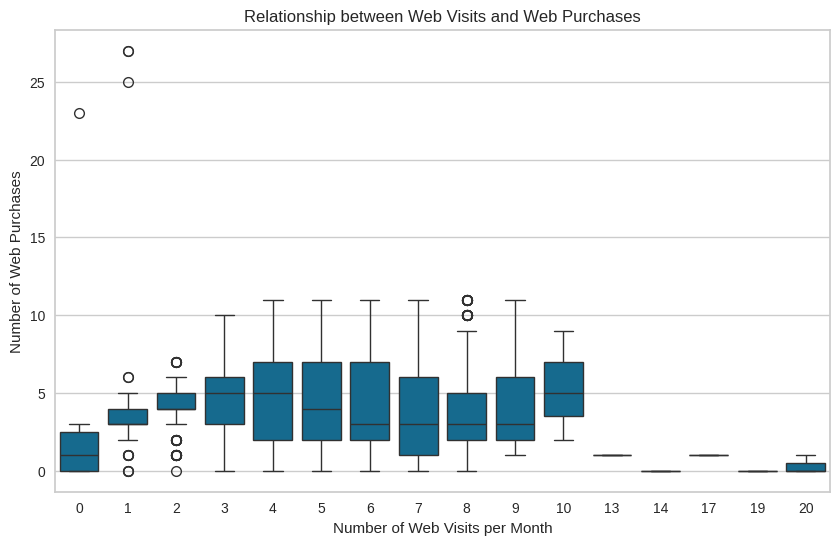

In [82]:
plt.figure(figsize=(10, 6))
sns.boxplot(data=data, x='NumWebVisitsMonth', y='NumWebPurchases')
plt.title('Relationship between Web Visits and Web Purchases')
plt.xlabel('Number of Web Visits per Month')
plt.ylabel('Number of Web Purchases')
plt.show()

##11)Feature engineering for CATEGORICAL VARIABLES

In [83]:
# Identify columns with object or categorical data types (likely categorical variables)
categorical_variables = data.select_dtypes(include=['object', 'category']).columns.tolist()

# Print the columns identified as categorical variables
print("Categorical variables in the dataset:")
print(categorical_variables)


Categorical variables in the dataset:
['Education', 'Marital_Status']


In [84]:
data['Education'].unique()

array(['Graduate', 'PhD', 'PostGraduate', 'UnderGraduate'], dtype=object)

In [85]:
data['Marital_Status'].unique()

array(['Single', 'Together', 'Married', 'Others'], dtype=object)

In [86]:
data['Education'] = data['Education'].map({'UnderGraduate':0,'Graduate':1, 'PostGraduate':2, 'PhD': 3})

In [87]:
data['Education'].unique()

array([1, 3, 2, 0])

In [88]:
data['Marital_Status'] = data['Marital_Status'].map({'Single':0,'Married':1,'Together':2,'Others':3})

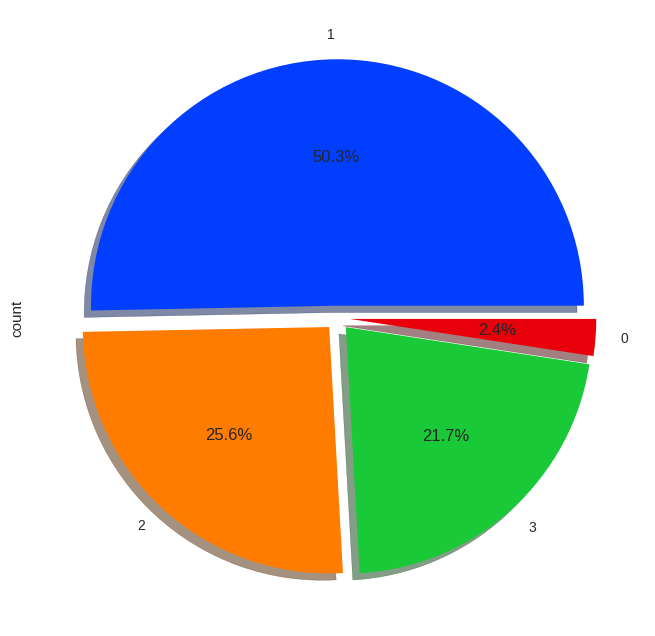

In [89]:
data['Education'].value_counts().plot.pie(explode=[0.05,0.05,0.05,0.05], autopct='%1.1f%%', shadow=True, figsize=(8,8), colors=sns.color_palette('bright'));

In [90]:
data['Marital_Status'].value_counts()

Marital_Status
1    864
2    580
0    480
3    316
Name: count, dtype: int64

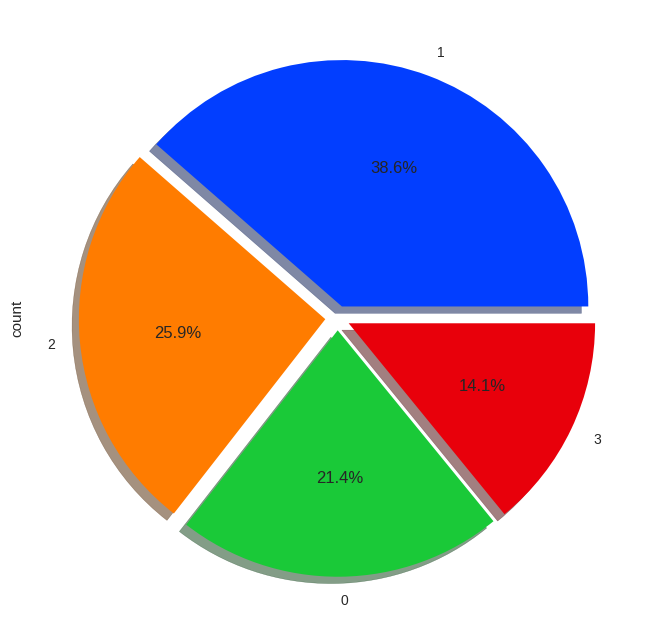

In [91]:
data['Marital_Status'].value_counts().plot.pie(explode=[0.05,0.05,0.05,0.05], autopct='%1.1f%%', shadow=True, figsize=(8,8), colors=sns.color_palette('bright'));

<ipython-input-92-fdf7168d6e57>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Education', y='Income', data=data, palette='muted')


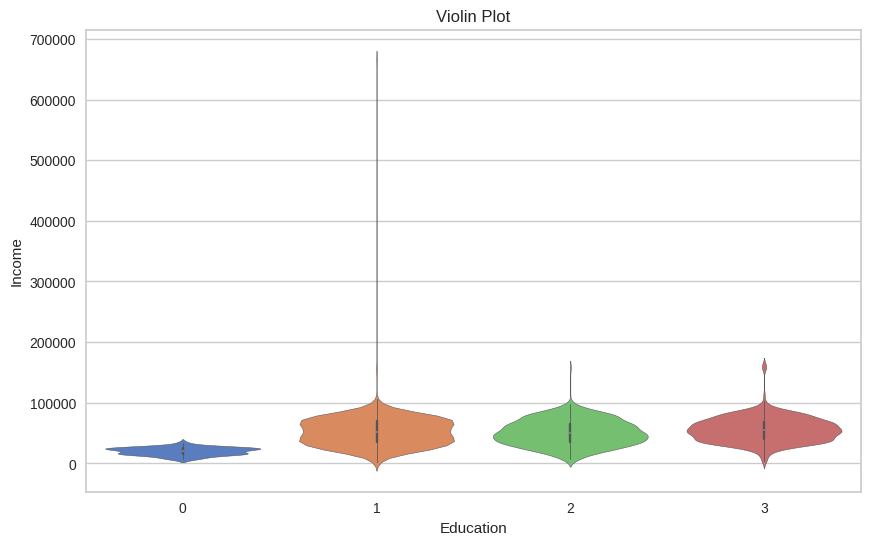

In [92]:
# Create a violin plot
plt.figure(figsize=(10, 6))  # Set the figure size
sns.violinplot(x='Education', y='Income', data=data, palette='muted')
plt.title('Violin Plot')  # Set the title of the plot
plt.xlabel('Education')  # Set the label for the x-axis
plt.ylabel('Income')  # Set the label for the y-axis
plt.show()  # Display the plot


<ipython-input-93-e068c192d669>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Marital_Status', y='Income', data=data, palette='muted')


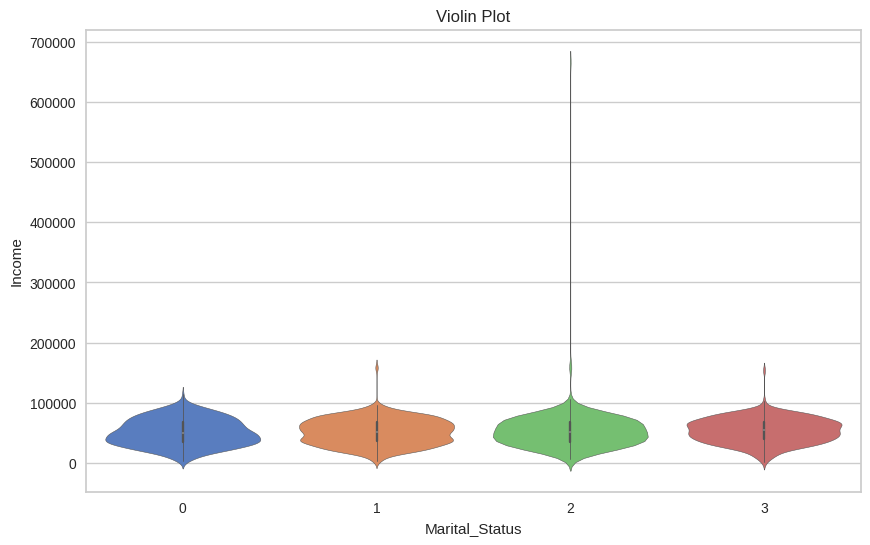

In [93]:
# Create a violin plot
plt.figure(figsize=(10, 6))  # Set the figure size
sns.violinplot(x='Marital_Status', y='Income', data=data, palette='muted')
plt.title('Violin Plot')  # Set the title of the plot
plt.xlabel('Marital_Status')  # Set the label for the x-axis
plt.ylabel('Income')  # Set the label for the y-axis
plt.show()  # Display the plot

<ipython-input-94-8200f79dab32>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Education', y='Expenses', data=data, palette='muted')


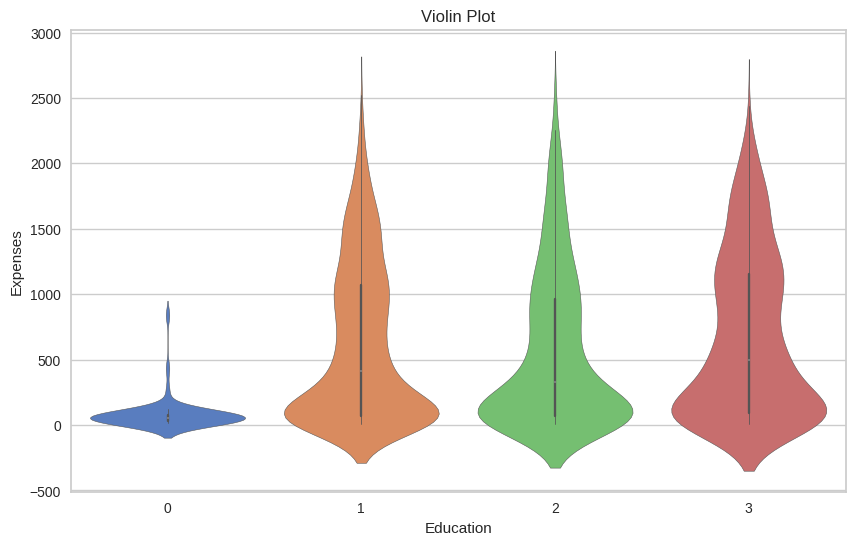

In [94]:
# Create a violin plot
plt.figure(figsize=(10, 6))  # Set the figure size
sns.violinplot(x='Education', y='Expenses', data=data, palette='muted')
plt.title('Violin Plot')  # Set the title of the plot
plt.xlabel('Education')  # Set the label for the x-axis
plt.ylabel('Expenses')  # Set the label for the y-axis
plt.show()  # Display the plot

<ipython-input-95-f415e7ef3f25>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='Marital_Status', y='Expenses', data=data, palette='muted')


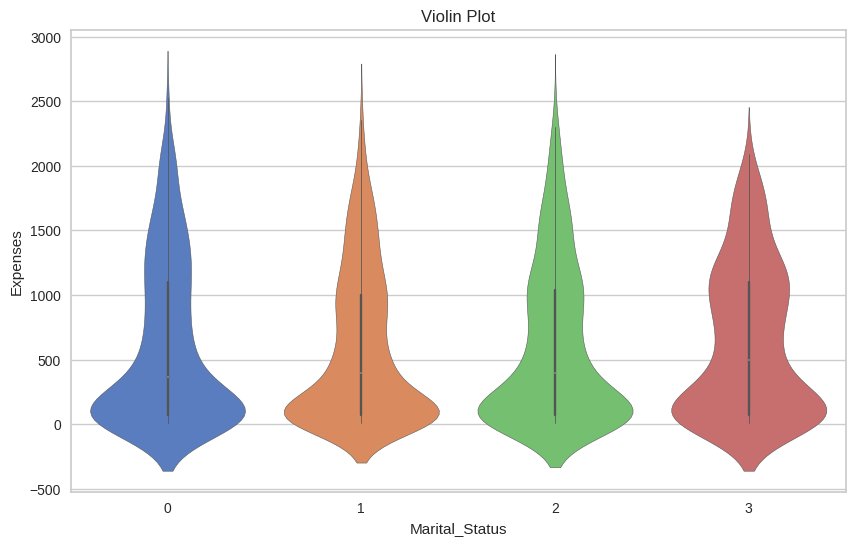

In [95]:
# Create a violin plot
plt.figure(figsize=(10, 6))  # Set the figure size
sns.violinplot(x='Marital_Status', y='Expenses', data=data, palette='muted')
plt.title('Violin Plot')  # Set the title of the plot
plt.xlabel('Marital_Status')  # Set the label for the x-axis
plt.ylabel('Expenses')  # Set the label for the y-axis
plt.show()  # Display the plot

## Dropping the unnecessary columns

In [96]:
# Drop Unnecessary Columns from the DATA
data.drop(columns=['ID', 'Year_Birth', 'Dt_Customer','AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'Customer_For','AcceptedCmp1','AcceptedCmp2', 'TotalAcceptedCmp','Complain','Response'], inplace=True)

In [97]:
data.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
0,1,0,58138.0,0,0,58,635,88,546,172,...,88,3,8,10,4,7,67,0,1617,25
1,1,0,46344.0,1,1,38,11,1,6,2,...,6,2,1,1,2,5,70,2,27,6
2,1,2,71613.0,0,0,26,426,49,127,111,...,42,1,8,2,10,4,59,0,776,21
3,1,2,26646.0,1,0,26,11,4,20,10,...,5,2,2,0,4,6,40,1,53,8
4,3,1,58293.0,1,0,94,173,43,118,46,...,15,5,5,3,6,5,43,1,422,19


In [98]:
corr1 = data.corr()
corr1

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
Education,1.000000,0.041763,0.101863,-0.040800,0.100790,-0.023436,0.162894,-0.086108,0.008169,-0.091288,...,-0.113155,0.027095,0.068249,0.056934,0.066240,-0.035714,0.142586,0.043785,0.064540,0.081250
Marital_Status,0.041763,1.000000,0.038800,-0.045694,0.103210,0.004586,0.039180,0.008900,-0.023921,0.015762,...,0.027407,0.039069,0.050289,0.023019,0.020443,-0.000513,0.177193,0.042033,0.018003,0.045457
Income,0.101863,0.038800,1.000000,-0.425326,0.018965,-0.004061,0.576903,0.428791,0.577805,0.437564,...,0.321938,-0.082315,0.380554,0.586826,0.526600,-0.549785,0.160899,-0.290858,0.664775,0.563450
Kidhome,-0.040800,-0.045694,-0.425326,1.000000,-0.036133,0.008827,-0.496297,-0.372581,-0.437129,-0.387644,...,-0.349595,0.221798,-0.361647,-0.502237,-0.499683,0.447846,-0.230176,0.689971,-0.556669,-0.477895
Teenhome,0.100790,0.103210,0.018965,-0.036133,1.000000,0.016198,0.004846,-0.176764,-0.261160,-0.204187,...,-0.021725,0.387741,0.155500,-0.110769,0.050695,0.134884,0.352111,0.698433,-0.138384,0.133163
Recency,-0.023436,0.004586,-0.004061,0.008827,0.016198,1.000000,0.016064,-0.004306,0.023056,0.001079,...,0.016693,-0.001098,-0.010726,0.025110,0.000799,-0.021445,0.019871,0.018053,0.020433,0.005740
MntWines,0.162894,0.039180,0.576903,-0.496297,0.004846,0.016064,1.000000,0.389637,0.562667,0.399753,...,0.387516,0.010940,0.542265,0.635226,0.642100,-0.320653,0.157773,-0.351909,0.891839,0.712789
MntFruits,-0.086108,0.008900,0.428791,-0.372581,-0.176764,-0.004306,0.389637,1.000000,0.543105,0.594804,...,0.392995,-0.132114,0.296735,0.487917,0.461758,-0.418383,0.017917,-0.394853,0.614229,0.455461
MntMeatProducts,0.008169,-0.023921,0.577805,-0.437129,-0.261160,0.023056,0.562667,0.543105,1.000000,0.568402,...,0.350609,-0.122415,0.293761,0.723827,0.479659,-0.539470,0.030872,-0.502208,0.842965,0.554229
MntFishProducts,-0.091288,0.015762,0.437564,-0.387644,-0.204187,0.001079,0.399753,0.594804,0.568402,1.000000,...,0.422875,-0.139361,0.293681,0.534478,0.459855,-0.446003,0.041625,-0.425503,0.642818,0.469454


<Axes: >

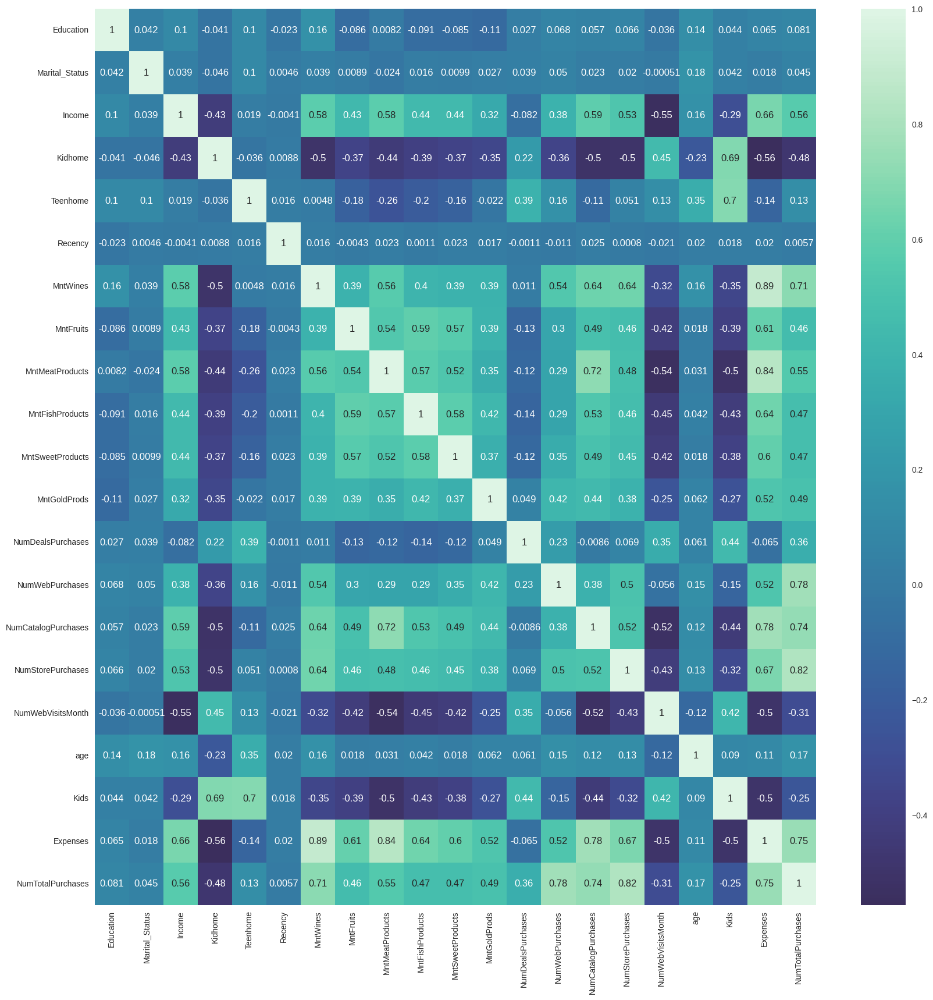

In [99]:
plt.figure(figsize=(20,20))
sns.heatmap(corr1, annot = True, cmap = 'mako', center = 0)

In [100]:
# Set the correlation thresholds (adjust as needed)
positive_correlation_threshold_low = 0.6
positive_correlation_threshold_high = 1.0
negative_correlation_threshold_low = -0.4
negative_correlation_threshold_high = -0.3

# Select features with positive correlation within the threshold range
positively_correlated_features = set()
for i in range(len(corr1.columns)):
    for j in range(i):
        correlation_value = corr1.iloc[i, j]
        if positive_correlation_threshold_low <= correlation_value <= positive_correlation_threshold_high:
            colname_i = corr1.columns[i]
            colname_j = corr1.columns[j]
            positively_correlated_features.add(colname_i)
            positively_correlated_features.add(colname_j)

# Select features with negative correlation within the threshold range
negatively_correlated_features = set()
for i in range(len(corr1.columns)):
    for j in range(i):
        correlation_value = corr1.iloc[i, j]
        if negative_correlation_threshold_low <= correlation_value <= negative_correlation_threshold_high:
            colname_i = corr1.columns[i]
            colname_j = corr1.columns[j]
            negatively_correlated_features.add(colname_i)
            negatively_correlated_features.add(colname_j)

# Print selected features
print("Positively correlated features:")
print(positively_correlated_features)

print("\nNegatively correlated features:")
print(negatively_correlated_features)

Positively correlated features:
{'NumCatalogPurchases', 'Expenses', 'Kidhome', 'MntWines', 'NumTotalPurchases', 'MntSweetProducts', 'NumStorePurchases', 'Teenhome', 'NumWebPurchases', 'MntFishProducts', 'Income', 'MntFruits', 'Kids', 'MntMeatProducts'}

Negatively correlated features:
{'Kidhome', 'MntWines', 'MntSweetProducts', 'Kids', 'NumStorePurchases', 'NumWebPurchases', 'MntFishProducts', 'NumWebVisitsMonth', 'MntGoldProds', 'MntFruits', 'NumTotalPurchases'}


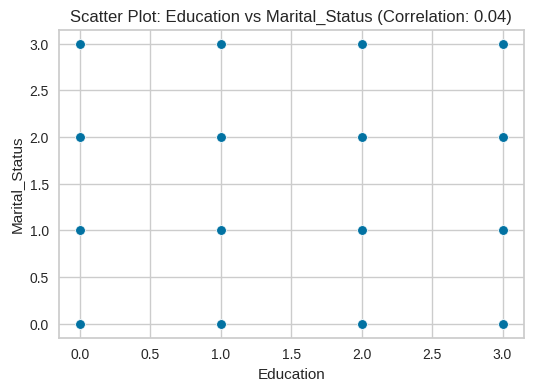

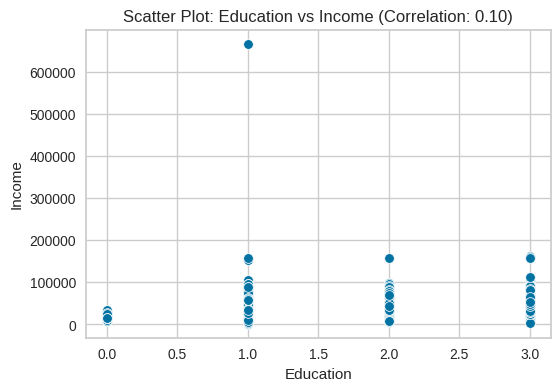

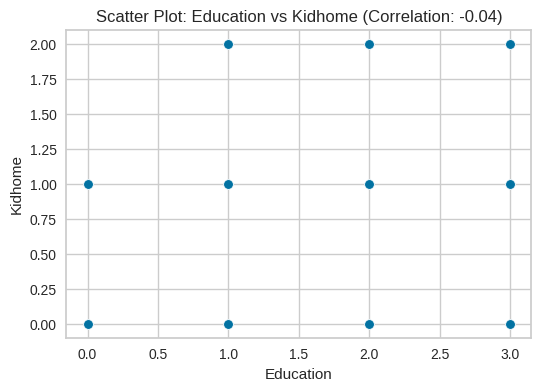

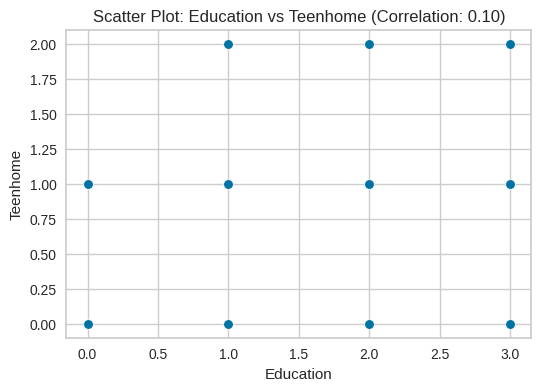

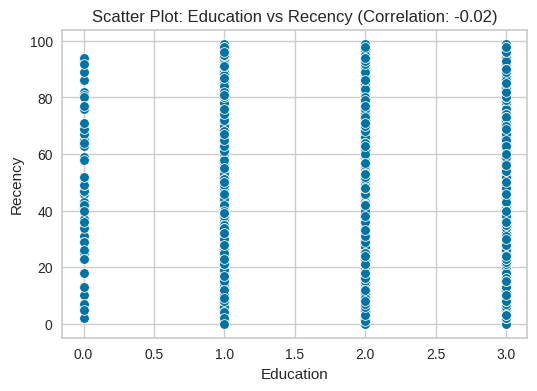

...

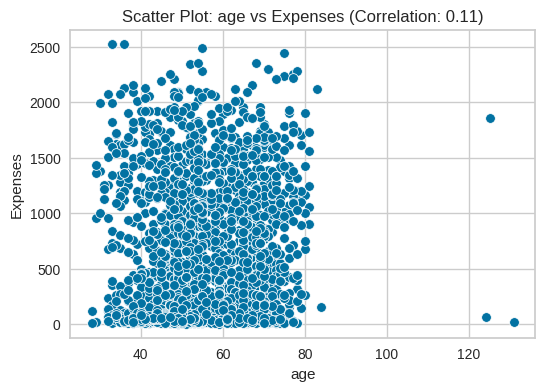

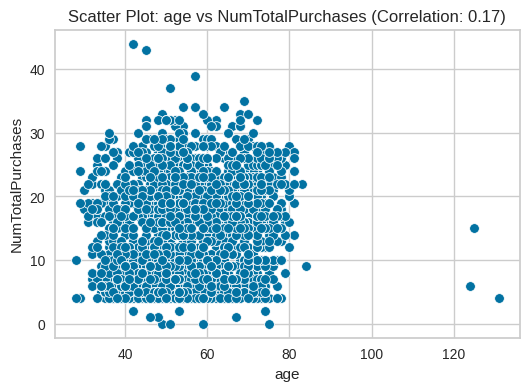

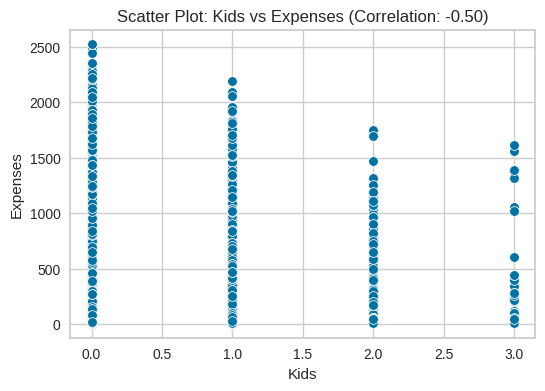

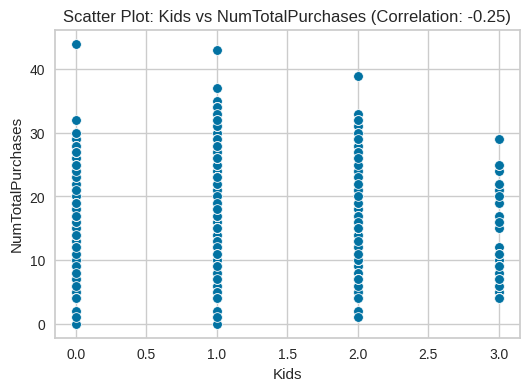

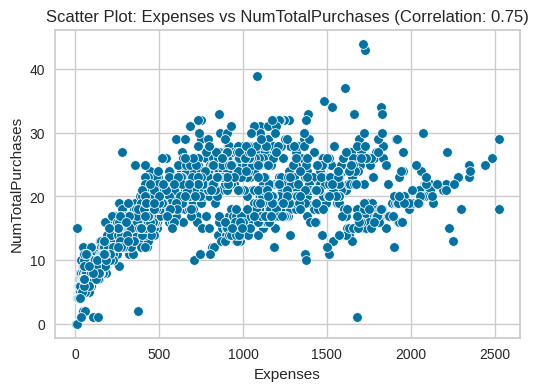

In [101]:
# Create scatter plots for each pair of variables
for i in range(len(corr1)):
    for j in range(i+1, len(corr1)):
        plt.figure(figsize=(6, 4))
        sns.scatterplot(x=data.columns[i], y=data.columns[j], data=data)
        plt.title(f'Scatter Plot: {data.columns[i]} vs {data.columns[j]} (Correlation: {corr1.iloc[i, j]:.2f})')
        plt.show()


Analyzing a correlation network involves interpreting the relationships between variables depicted in the network graph. Here are some steps you can take to analyze a correlation network:

1. **Identify Clusters**: Look for groups or clusters of nodes (variables) that are densely interconnected. These clusters may represent subsets of variables that are strongly correlated with each other.

2. **Degree Centrality**: Calculate the degree centrality of nodes, which measures the number of connections each node has in the network. Nodes with higher degree centrality are more central to the network and may play a more important role in mediating correlations between other variables.

3. **Betweenness Centrality**: Compute the betweenness centrality of nodes, which measures the extent to which nodes act as intermediaries in connecting other nodes. Nodes with high betweenness centrality may serve as bridges between different clusters or subsets of variables.

4. **Edge Weights**: Examine the weights of edges between nodes, which represent the strength of correlation between variables. Stronger correlations are represented by thicker or darker edges, while weaker correlations are represented by thinner or lighter edges.

5. **Identify Outliers**: Look for nodes or edges that deviate significantly from the overall structure of the network. Outliers may indicate variables that are highly influential or unusual in terms of their correlations with other variables.

6. **Compare with Domain Knowledge**: Compare the structure of the correlation network with existing domain knowledge or hypotheses about the relationships between variables. Are the observed correlations consistent with what is known about the system or phenomenon under study?

7. **Explore Subnetworks**: Investigate subnetworks or modules within the correlation network that exhibit distinct patterns of correlations. Subnetworks may represent functional modules or subsystems within the larger network that have specialized roles or relationships.

8. **Visualize and Interpret**: Use visualization techniques such as node coloring, node size, or layout algorithms to enhance the interpretability of the correlation network. Experiment with different visualization parameters to highlight specific aspects of the network structure.

By analyzing the correlation network using these approaches, you can gain insights into the relationships between variables in your dataset and identify patterns, clusters, and outliers that may be relevant for further investigation or hypothesis testing.

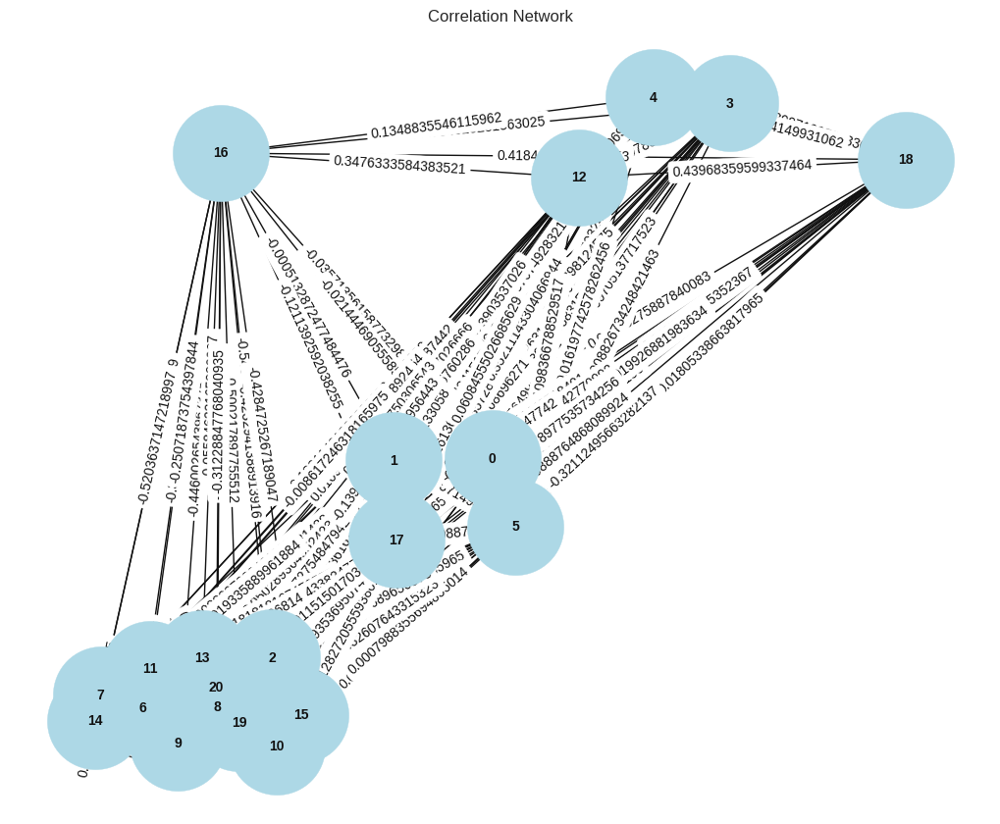

In [102]:
# Create a graph object
G = nx.Graph()

# Add nodes for each variable
for i, variable in enumerate(data.columns):
    G.add_node(i, label=variable)

# Add edges between variables with non-zero correlation coefficients
for i in range(len(corr1)):
    for j in range(i+1, len(corr1)):
        if corr1.iloc[i, j] != 0:
            G.add_edge(i, j, weight=corr1.iloc[i, j])

# Draw the correlation network
plt.figure(figsize=(10, 8))
pos = nx.spring_layout(G)  # Position nodes using spring layout
nx.draw(G, pos, with_labels=True, node_size=5000, node_color='lightblue', font_size=10, font_weight='bold')
labels = nx.get_edge_attributes(G, 'weight')
nx.draw_networkx_edge_labels(G, pos, edge_labels=labels)
plt.title('Correlation Network')
plt.show()


In [103]:
# Convert the correlation matrix to an adjacency matrix
adjacency_matrix = corr1.copy()

# Threshold the adjacency matrix to remove weak correlations (optional)
threshold = 0.3  # Define a threshold for strong correlations
adjacency_matrix[adjacency_matrix < threshold] = 0

# Print the adjacency matrix
print("Adjacency Matrix:")
print(adjacency_matrix)


Adjacency Matrix:
                     Education  Marital_Status    Income   Kidhome  Teenhome  \
Education                  1.0             0.0  0.000000  0.000000  0.000000   
Marital_Status             0.0             1.0  0.000000  0.000000  0.000000   
Income                     0.0             0.0  1.000000  0.000000  0.000000   
Kidhome                    0.0             0.0  0.000000  1.000000  0.000000   
Teenhome                   0.0             0.0  0.000000  0.000000  1.000000   
Recency                    0.0             0.0  0.000000  0.000000  0.000000   
MntWines                   0.0             0.0  0.576903  0.000000  0.000000   
MntFruits                  0.0             0.0  0.428791  0.000000  0.000000   
MntMeatProducts            0.0             0.0  0.577805  0.000000  0.000000   
MntFishProducts            0.0             0.0  0.437564  0.000000  0.000000   
MntSweetProducts           0.0             0.0  0.436131  0.000000  0.000000   
MntGoldProds          

Degree Centrality: Calculate the degree centrality of nodes, which measures the number of connections each node has in the network. Nodes with higher degree centrality are more central to the network and may play a more important role in mediating correlations between other variables.

In [104]:
import pandas as pd
import networkx as nx

# Assuming 'adjacency_matrix' is your adjacency matrix DataFrame

# Convert the adjacency matrix to a NetworkX graph
G = nx.from_pandas_adjacency(adjacency_matrix)

# Calculate the degree centrality
degree_centrality = nx.degree_centrality(G)

# Create a DataFrame to display the degree centrality values
degree_centrality_df = pd.DataFrame.from_dict(degree_centrality, orient='index', columns=['Degree Centrality'])

# Sort the DataFrame by degree centrality values
degree_centrality_df = degree_centrality_df.sort_values(by='Degree Centrality', ascending=False)

# Print or display the degree centrality DataFrame
print(degree_centrality_df)


                     Degree Centrality
NumTotalPurchases                 0.70
MntWines                          0.65
Expenses                          0.65
NumStorePurchases                 0.65
NumCatalogPurchases               0.65
MntGoldProds                      0.65
MntSweetProducts                  0.65
Income                            0.65
MntFruits                         0.60
MntMeatProducts                   0.60
MntFishProducts                   0.60
NumWebPurchases                   0.50
NumDealsPurchases                 0.30
Kids                              0.30
Teenhome                          0.25
NumWebVisitsMonth                 0.25
Kidhome                           0.20
age                               0.15
Marital_Status                    0.10
Recency                           0.10
Education                         0.10


In [105]:
import networkx as nx

# Assuming 'G' is your NetworkX graph

# Calculate the betweenness centrality
betweenness_centrality = nx.betweenness_centrality(G)

# Print the betweenness centrality for each node
for node, centrality in betweenness_centrality.items():
    print(f"Node {node}: Betweenness Centrality = {centrality}")


Node Education: Betweenness Centrality = 0.0
Node Marital_Status: Betweenness Centrality = 0.0
Node Income: Betweenness Centrality = 0.001973684210526316
Node Kidhome: Betweenness Centrality = 0.0
Node Teenhome: Betweenness Centrality = 0.08421052631578947
Node Recency: Betweenness Centrality = 0.0
Node MntWines: Betweenness Centrality = 0.001973684210526316
Node MntFruits: Betweenness Centrality = 0.0
Node MntMeatProducts: Betweenness Centrality = 0.0
Node MntFishProducts: Betweenness Centrality = 0.0
Node MntSweetProducts: Betweenness Centrality = 0.001973684210526316
Node MntGoldProds: Betweenness Centrality = 0.001973684210526316
Node NumDealsPurchases: Betweenness Centrality = 0.32105263157894737
Node NumWebPurchases: Betweenness Centrality = 0.0
Node NumCatalogPurchases: Betweenness Centrality = 0.001973684210526316
Node NumStorePurchases: Betweenness Centrality = 0.001973684210526316
Node NumWebVisitsMonth: Betweenness Centrality = 0.034210526315789476
Node age: Betweenness Cent

In [106]:
def detect_outliers(d):
  for i in d:
    Q3, Q1 = np.percentile(data[i], [75 ,25])
    IQR = Q3 - Q1

    ul = Q3+1.5*IQR
    ll = Q1-1.5*IQR

    outliers = data[i][(data[i] > ul) | (data[i] < ll)]
    print(f'*** {i} outlier points***', '\n', outliers, '\n')

In [107]:
detect_outliers(data[['age','Income','Expenses']])

*** age outlier points*** 
 192    124
239    131
339    125
Name: age, dtype: int64 

*** Income outlier points*** 
 164     157243.0
617     162397.0
655     153924.0
687     160803.0
1300    157733.0
1653    157146.0
2132    156924.0
2233    666666.0
Name: Income, dtype: float64 

*** Expenses outlier points*** 
 1179    2525
1492    2524
1572    2525
Name: Expenses, dtype: int64 



In [108]:
# Remove outliers from the original dataset
data = data.drop([192,239,339,2233])

In [109]:
data.shape

(2236, 21)

In [110]:
scaler = StandardScaler()
data_scaled = pd.DataFrame(scaler.fit_transform(data), columns = data.columns)

In [111]:
data_scaled.head(3)

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
0,-0.792105,-1.375079,0.288947,-0.824939,-0.930615,0.306856,0.983228,1.554170,1.679746,2.461068,...,0.845669,0.348738,1.407639,2.509801,-0.552429,0.692865,1.016868,-1.264308,1.680176,1.319340
1,-0.792105,-1.375079,-0.262003,1.032627,0.905974,-0.383971,-0.871064,-0.636431,-0.713455,-0.650414,...,-0.729742,-0.168700,-1.110921,-0.568970,-1.167738,-0.131421,1.273264,1.395139,-0.962202,-1.155857
2,-0.792105,0.698902,0.918423,-0.824939,-0.930615,-0.798467,0.362159,0.572177,-0.177201,1.344595,...,-0.038098,-0.686137,1.407639,-0.226884,1.293496,-0.543564,0.333146,-1.264308,0.282541,0.798246


## Dimentionality Reduction

In [112]:
pca = PCA(n_components=3)
pca_values = pca.fit_transform(data_scaled)

In [113]:
pca_values

array([[ 4.50567835, -0.50640633,  1.70962305],
       [-2.98486021,  0.23640898, -0.63336823],
       [ 2.28919327, -0.59292329, -0.0358334 ],
       ...,
       [ 1.9681642 , -0.93314106, -0.08497625],
       [ 2.26484731,  1.30015692, -1.22911376],
       [-2.2699241 ,  1.60168034, -1.18676242]])

In [114]:
# The amount of variance that each PCA explains is
var = pca.explained_variance_ratio_
var

array([0.38613471, 0.12189624, 0.06716931])

In [115]:
# Cumulative variance
var1 = np.cumsum(np.round(var,decimals = 4)*100)
var1

array([38.61, 50.8 , 57.52])

In [116]:
pca.components_

array([[ 0.01392757,  0.01072117,  0.29431873, -0.23732724, -0.04883908,
         0.00489628,  0.27556611,  0.2394186 ,  0.28145052,  0.24828418,
         0.23898281,  0.20072436, -0.03291916,  0.20253674,  0.28955362,
         0.26737633, -0.21692504,  0.05366963, -0.20524907,  0.33175654,
         0.28853251],
       [ 0.14029288,  0.11313837,  0.05806252,  0.0466241 ,  0.49217632,
         0.00771187,  0.14135968, -0.10903715, -0.11545102, -0.11996678,
        -0.09092453,  0.06424616,  0.44871697,  0.29715334,  0.01511792,
         0.14871216,  0.18191526,  0.25834772,  0.38971983,  0.01699156,
         0.28929265],
       [-0.4198677 , -0.24593655, -0.17145156,  0.26982658, -0.18626334,
        -0.00709991, -0.05482037,  0.14376974,  0.01113081,  0.12570902,
         0.14072423,  0.24312764,  0.34277849,  0.19234802, -0.01717402,
         0.01859823,  0.30303402, -0.4816979 ,  0.05829513,  0.02510595,
         0.15728012]])

<ipython-input-117-a25b38f56816>:1: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x = list(range(1,4)), y = pca.explained_variance_, palette = 'GnBu_r')


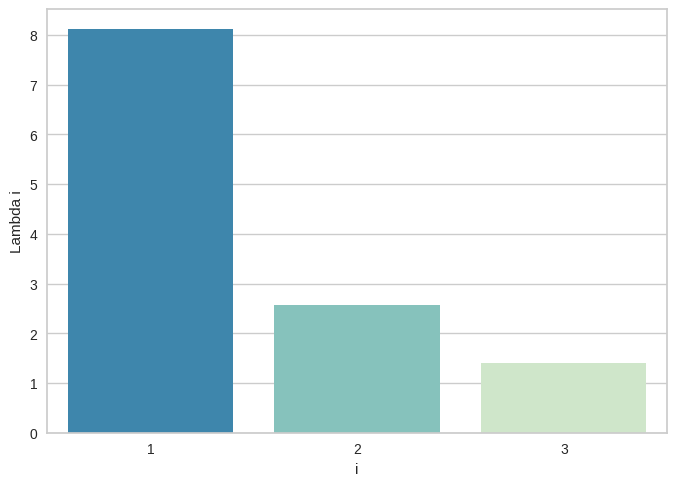

In [117]:
sns.barplot(x = list(range(1,4)), y = pca.explained_variance_, palette = 'GnBu_r')
plt.xlabel('i')
plt.ylabel('Lambda i');

In [118]:
data_pca = pd.DataFrame(pca_values[:,0:3],  columns=(['Col1','Col2','Col3']))

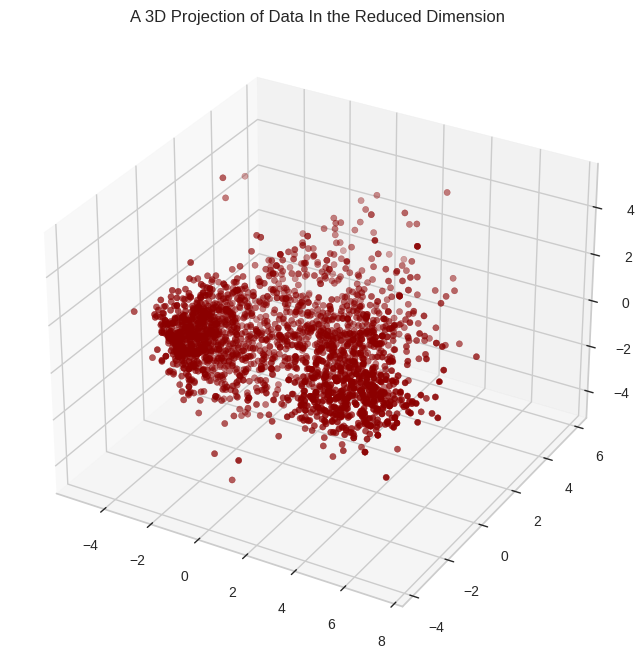

In [119]:
p = data_pca['Col1']
q = data_pca['Col2']
r = data_pca['Col3']
fig = plt.figure(figsize=(13,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(p,q,r, c='darkred', marker='o')

ax.set_title('A 3D Projection of Data In the Reduced Dimension')
plt.show()

## Hierarchical Clustering

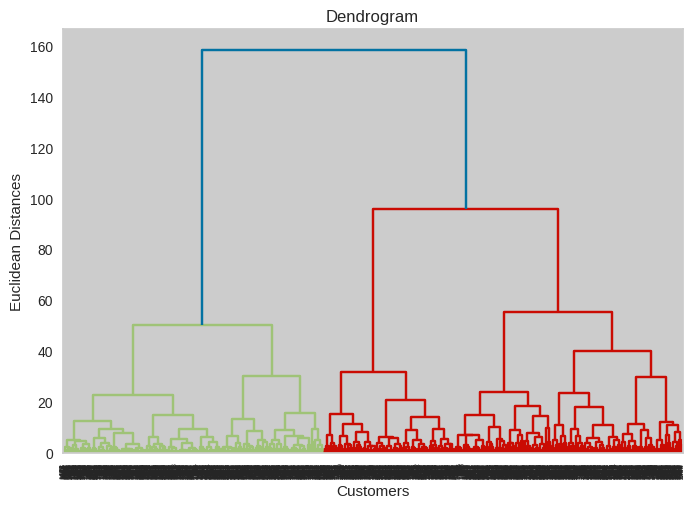

In [120]:
import scipy.cluster.hierarchy as sch
dendrogram = sch.dendrogram(sch.linkage(data_pca,method = 'ward'))
plt.title('Dendrogram')
plt.xlabel('Customers')
plt.ylabel('Euclidean Distances')
plt.show()

In [134]:
from sklearn.cluster import AgglomerativeClustering
hc = AgglomerativeClustering(n_clusters = 4,affinity = 'euclidean', linkage = 'ward')
y_hc = hc.fit_predict(data_pca)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [135]:
y_hc

array([2, 0, 2, ..., 2, 3, 0])

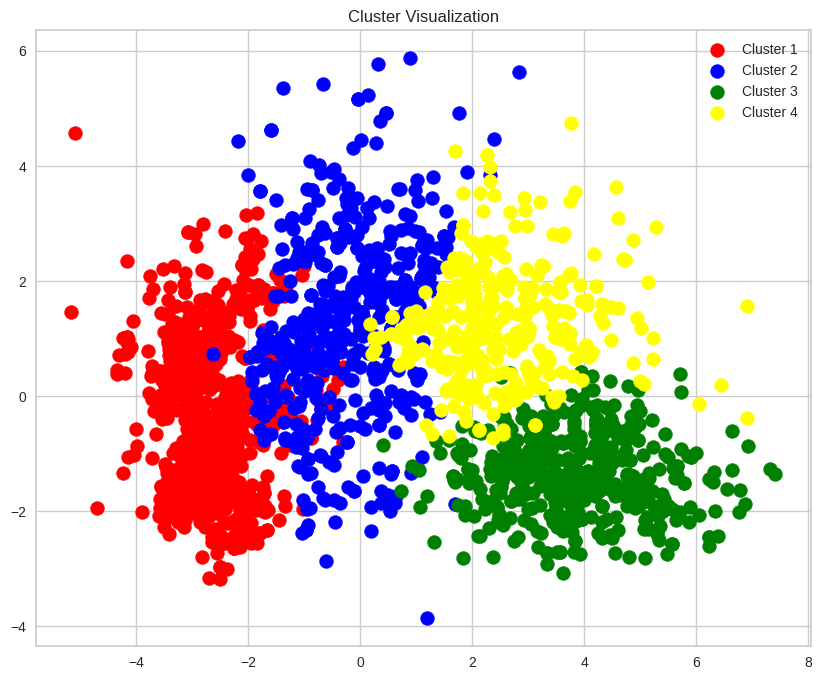

In [136]:
# Define colors for each cluster for visualization
colors1 = ['red', 'blue', 'green', 'yellow']

plt.figure(figsize=(10, 8))
for i, color in enumerate(colors1):
    cluster_indices1 = y_hc == i
    plt.scatter(data_pca.iloc[cluster_indices1, 0], data_pca.iloc[cluster_indices1, 1], s=100, color=color, label=f'Cluster {i+1}')


plt.title('Cluster Visualization')
plt.legend()
plt.show()

## DBSCAN CLUSTERING

In [124]:
#DBSCAN Clustering
from sklearn.cluster import DBSCAN
dbscan=DBSCAN()
dbscan.fit(data_pca)

DBSCAN()

In [125]:
#Finding Out Epsilon

neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(data_pca)
distances, indices = nbrs.kneighbors(data_pca)

In [126]:
distances

array([[0.        , 0.36138606],
       [0.        , 0.20558889],
       [0.        , 0.38494791],
       ...,
       [0.        , 0.4703433 ],
       [0.        , 0.14734465],
       [0.        , 0.32187772]])

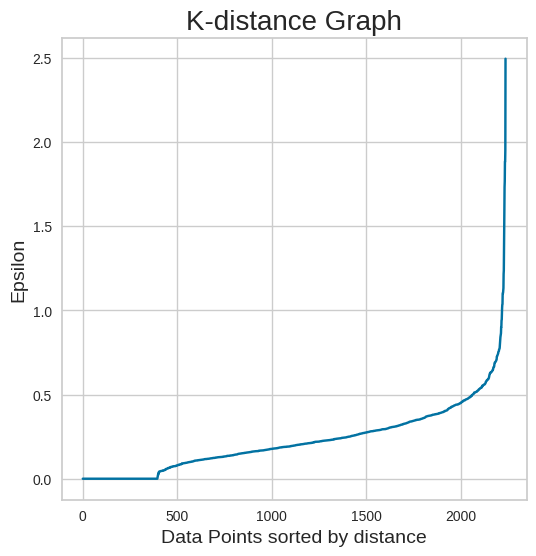

In [127]:
# Plotting K-distance Graph
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.figure(figsize=(6,6))
plt.plot(distances)
plt.title('K-distance Graph',fontsize=20)
plt.xlabel('Data Points sorted by distance',fontsize=14)
plt.ylabel('Epsilon',fontsize=14)
plt.show()

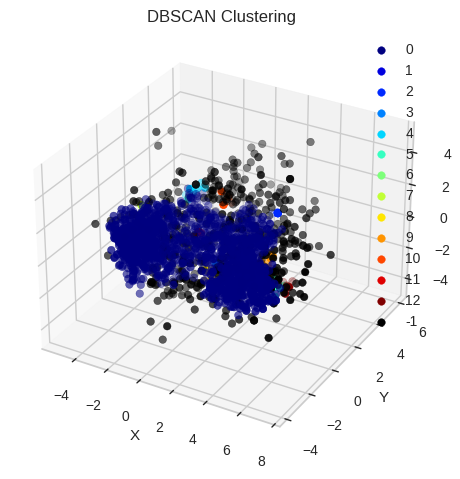

In [128]:
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Assuming data is your dataset with three columns (e.g., X, Y, Z)
# Initialize DBSCAN with parameters
dbscan = DBSCAN(eps=0.5, min_samples=5)

# Fit the model to the data
dbscan.fit(data_pca)

# Visualize the clusters in 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Plot each point with its assigned cluster
for label in set(dbscan.labels_):
    if label == -1:  # Outliers
        color = 'black'
    else:
        color = plt.cm.jet(label / max(dbscan.labels_))
    ax.scatter(data_pca.iloc[dbscan.labels_ == label, 0],  # X coordinate
               data_pca.iloc[dbscan.labels_ == label, 1],  # Y coordinate
               data_pca.iloc[dbscan.labels_ == label, 2],  # Z coordinate
               c=[color],
               label=label,
               s=30)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('DBSCAN Clustering')
plt.legend()
plt.show()


In [129]:
print(data_pca.shape)
print(dbscan.labels_.shape)

(2236, 3)
(2236,)


In [130]:
print(type(dbscan.labels_))

<class 'numpy.ndarray'>


## Decision Tree Clustering

In [131]:
from sklearn.tree import DecisionTreeClassifier
# Initialize DecisionTreeClassifier for clustering
tree_clf = DecisionTreeClassifier(max_depth=2)

# Fit the model to the data
y = np.arange(len(data_pca))
tree_clf.fit(data_pca, y)

# Predict cluster assignments for the data
cluster_assignments = tree_clf.predict(data_pca)

# Print cluster assignments
print("Cluster Assignments:", cluster_assignments)

Cluster Assignments: [0 0 0 ... 0 0 0]


In [132]:
np.unique(cluster_assignments)

array([   0,    9, 1843])

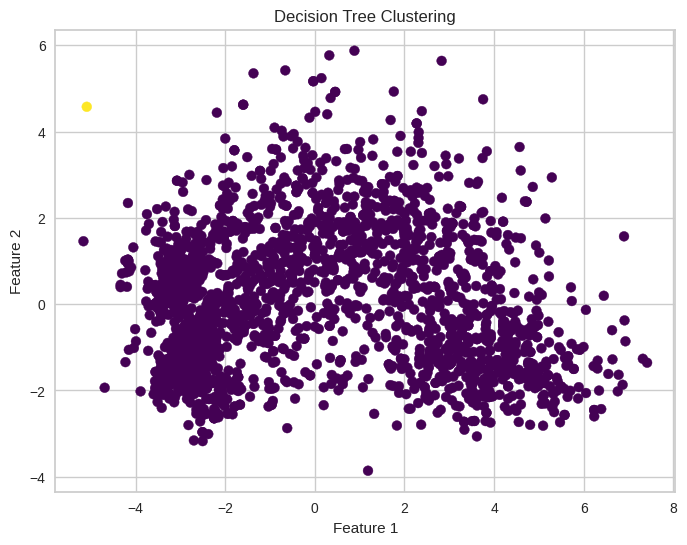

In [137]:
# Plotting the clusters
plt.figure(figsize=(8, 6))
plt.scatter(data_pca['Col1'], data_pca['Col2'], c=cluster_assignments, cmap='viridis', s=50)
plt.title('Decision Tree Clustering')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.show()

## KMEANS CLUSTERING

Finding the number of clusters by elbow method

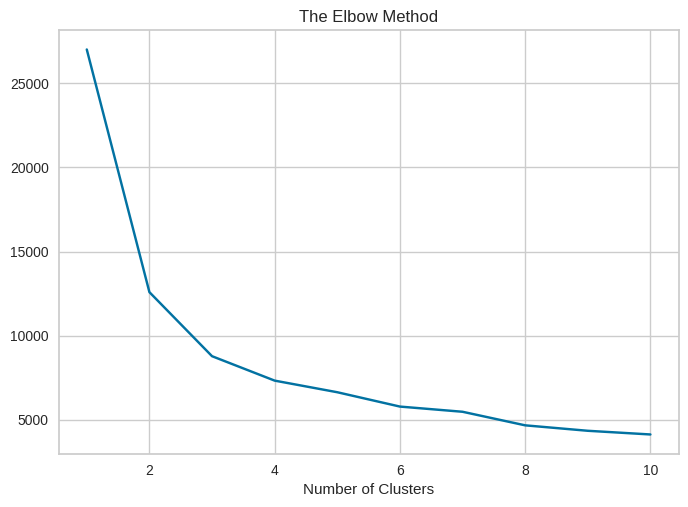

In [138]:
wcss = []
n_init = 10
for i in range (1,11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++',n_init = "auto", max_iter = 300, random_state = 0)
    kmeans.fit(data_pca)
    wcss.append(kmeans.inertia_)

plt.plot(range(1,11),wcss)
plt.title('The Elbow Method')
plt.xlabel("Number of Clusters")
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

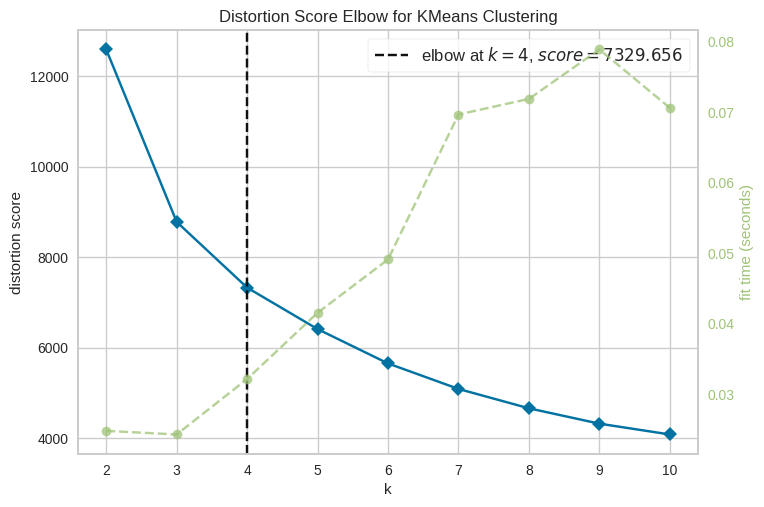

In [140]:
Elbow_M = KElbowVisualizer(KMeans(), k=10)
Elbow_M.fit(data_pca)
Elbow_M.show();

In [141]:
kmeans = KMeans(n_clusters = 4, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)

In [142]:
y_kmeans = kmeans.fit_predict(data_pca)

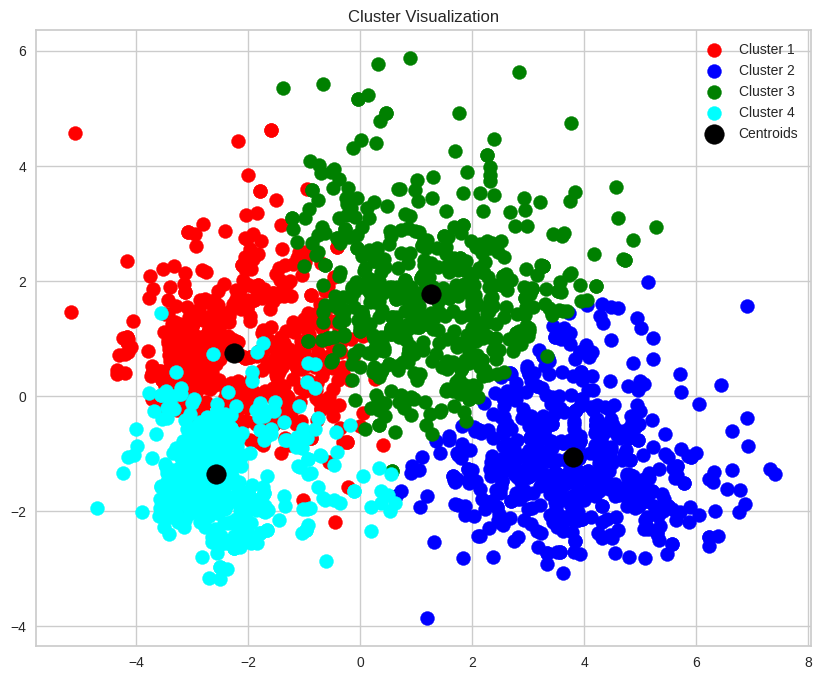

In [143]:
# Define colors for each cluster for visualization
colors = ['red', 'blue', 'green', 'cyan']

plt.figure(figsize=(10, 8))
for i, color in enumerate(colors):
    cluster_indices = y_kmeans == i
    plt.scatter(data_pca.iloc[cluster_indices, 0], data_pca.iloc[cluster_indices, 1], s=100, color=color, label=f'Cluster {i+1}')
plt.scatter(kmeans.cluster_centers_[:,0], kmeans.cluster_centers_[:,1], s=200, c= 'black',label = 'Centroids')
# If you also want to plot the centroids, you can add them here.
# For example, if you have an array 'centroids' with the centroids coordinates,
# you would use plt.scatter(centroids[:, 0], centroids[:, 1], s=300, c='yellow', label='Centroids')

plt.title('Cluster Visualization')
plt.legend()
plt.show()

In [144]:
data['Clusters'] = y_kmeans

In [145]:
data_pca['Clusters'] = y_kmeans

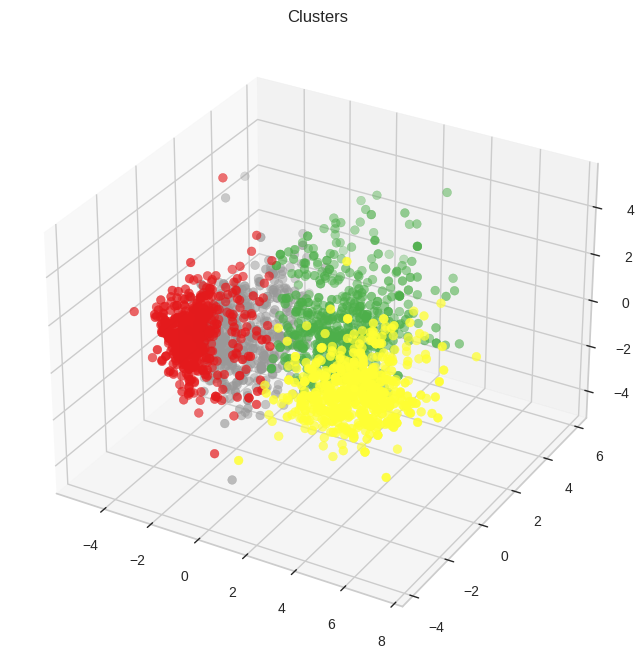

In [146]:
fig = plt.figure(figsize=(13,8))
ax = plt.subplot(111, projection='3d', label='bla')
ax.scatter(p, q, r, s=40, c=data_pca['Clusters'], marker='o', cmap='Set1_r')
ax.set_title('Clusters')
plt.show()

<ipython-input-147-ad3a8f446dfc>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  pl = sns.countplot(x=data_pca['Clusters'], palette= pal)


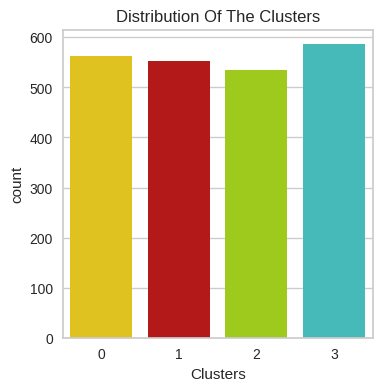

In [147]:
pal = ['gold','#cc0000', '#ace600','#33cccc']
plt.figure(figsize=(4,4))
pl = sns.countplot(x=data_pca['Clusters'], palette= pal)
pl.set_title('Distribution Of The Clusters')
plt.show()

<ipython-input-148-3751ed152777>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=data["Clusters"], y=data["Kids"],palette='rainbow')


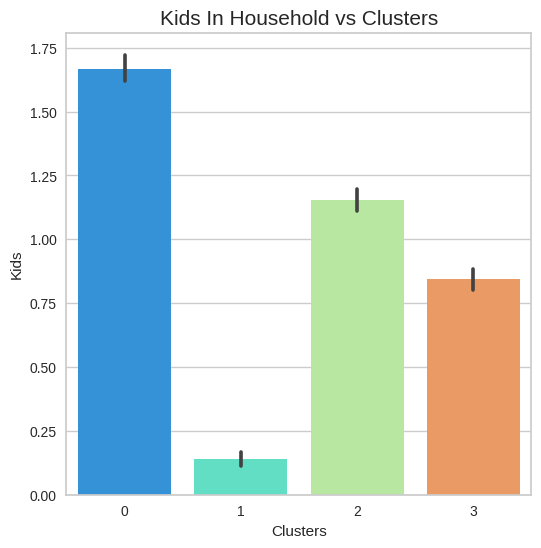

In [148]:
# Find out the customers which have kids in different clusters
plt.figure(figsize=(6, 6))
sns.barplot(x=data["Clusters"], y=data["Kids"],palette='rainbow')
plt.title("Kids In Household vs Clusters", size=15)
plt.show()

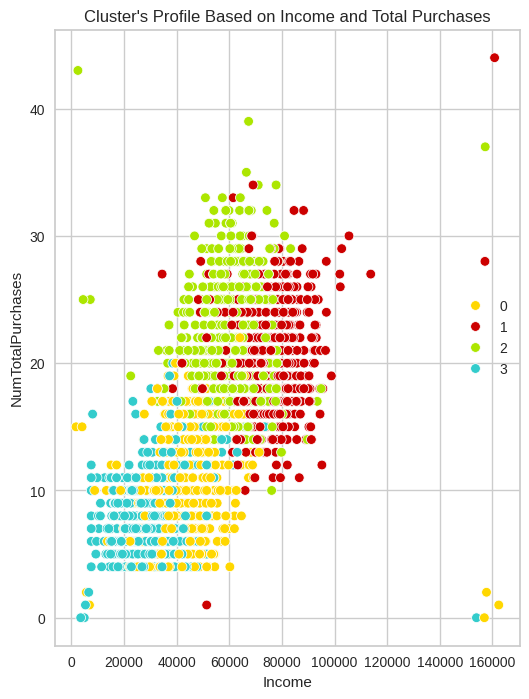

In [149]:
plt.figure(figsize=(6,8))
import seaborn as sns
pl = sns.scatterplot(data=data.iloc[:,0:-1], x=data['Income'], y=data['NumTotalPurchases'], hue=data['Clusters'], palette= pal)
pl.set_title("Cluster's Profile Based on Income and Total Purchases")
plt.legend();

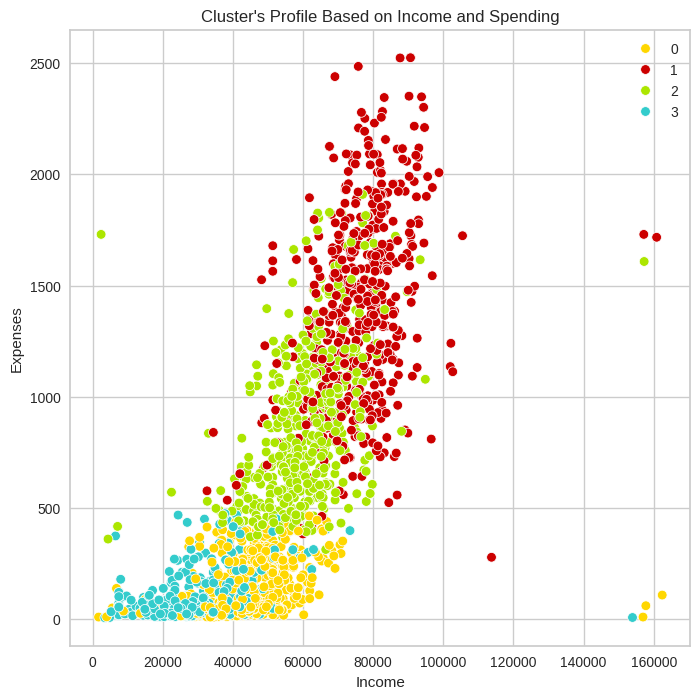

In [150]:
plt.figure(figsize=(8,8))
pl = sns.scatterplot(data=data.iloc[:,0:-1], x=data['Income'], y=data['Expenses'], hue=data['Clusters'], palette= pal)
pl.set_title("Cluster's Profile Based on Income and Spending")
plt.legend();

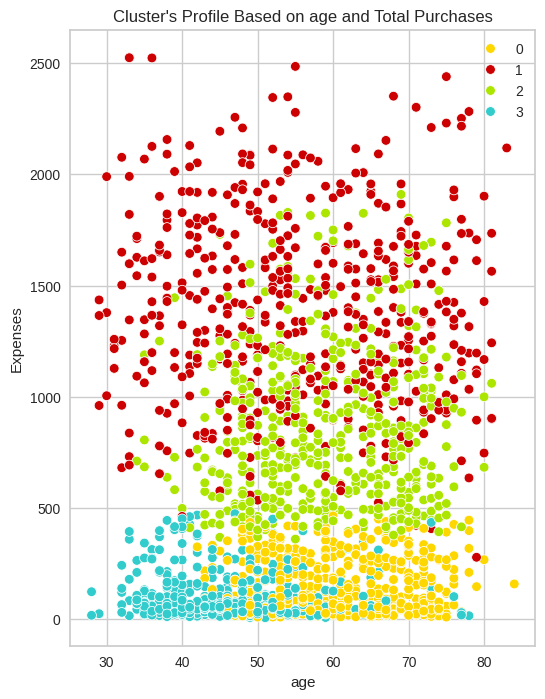

In [151]:
plt.figure(figsize=(6,8))
import seaborn as sns
pl = sns.scatterplot(data=data.iloc[:,0:-1], x=data['age'], y=data['Expenses'], hue=data['Clusters'], palette= pal)
pl.set_title("Cluster's Profile Based on age and Total Purchases")
plt.legend();

In [155]:
data.columns

Index(['Education', 'Marital_Status', 'Income', 'Kidhome', 'Teenhome',
       'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'age', 'Kids', 'Expenses',
       'NumTotalPurchases', 'Clusters'],
      dtype='object')

<Figure size 800x550 with 0 Axes>

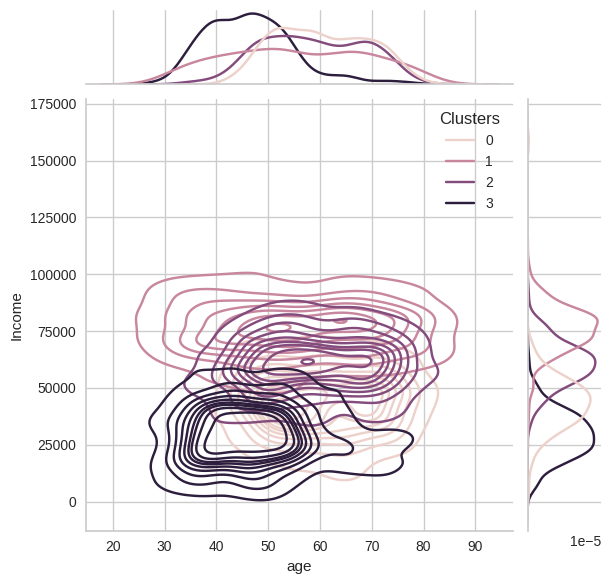

<Figure size 800x550 with 0 Axes>

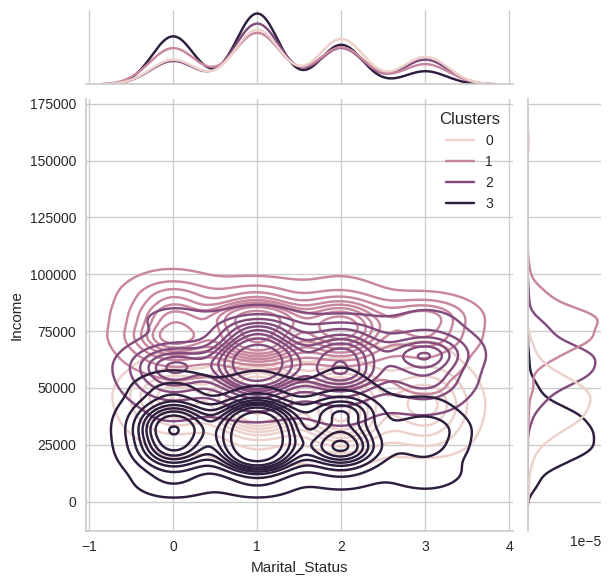

<Figure size 800x550 with 0 Axes>

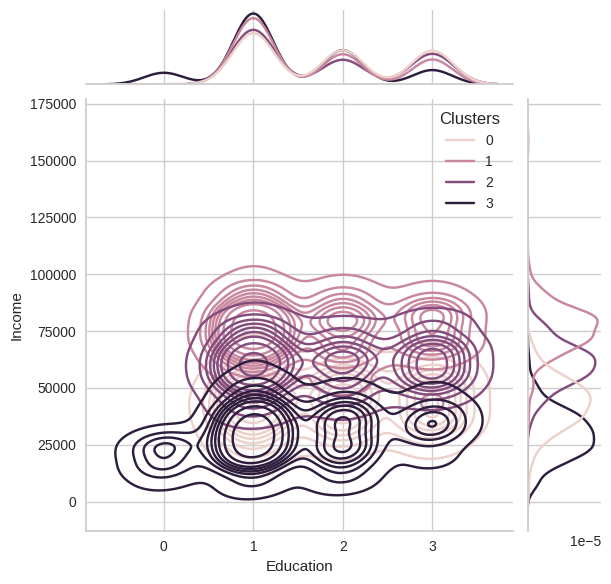

<Figure size 800x550 with 0 Axes>

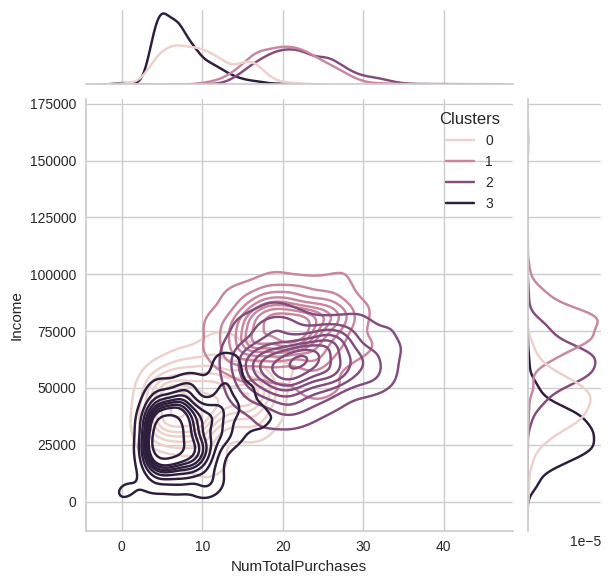

<Figure size 800x550 with 0 Axes>

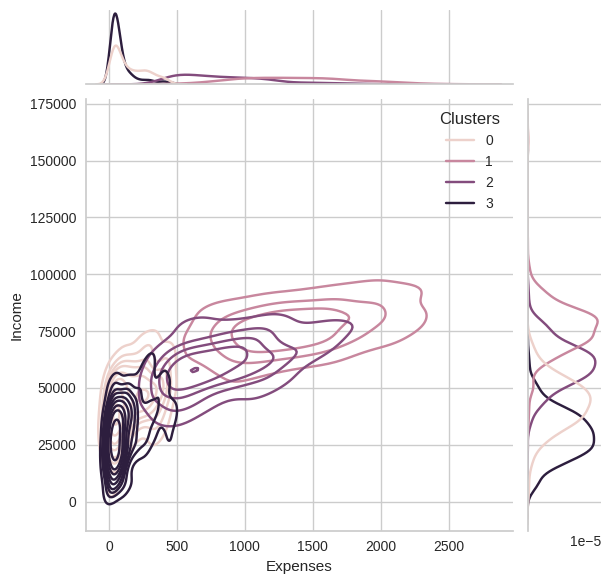

<Figure size 800x550 with 0 Axes>

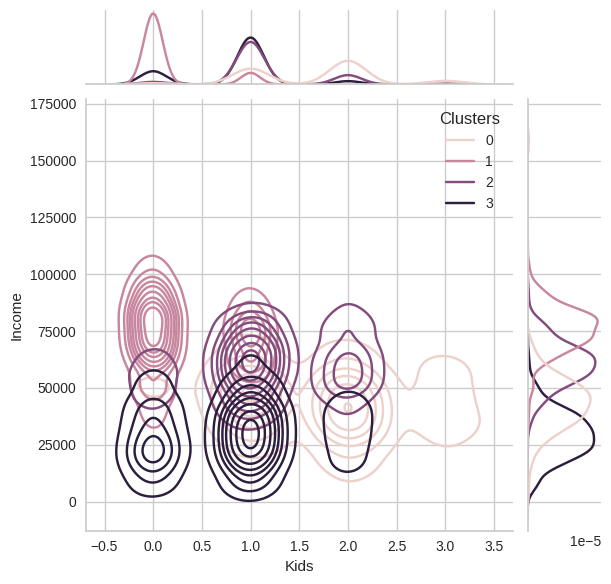

In [156]:
bar_palette = sns.color_palette()

Personal_Traits = ['age','Marital_Status','Education','NumTotalPurchases','Expenses','Kids']

for trait in Personal_Traits:
    plt.figure()
    sns.jointplot(x=data[trait], y=data["Income"], hue=data["Clusters"], kind="kde")
    plt.show()

**About Cluster 0:**
* Have Kids
* Average Income and Low Spending
* Aged between 40 and 80
* Most of them are Graduates

**About Cluster 1:**
* The majority of these people are not parents
* Mostly married with few singles
* High Income and High Spending
* Span all ages


**About Cluster 2:**
* Definitely a parent
* Mostly Married
* Majority of them have a kid at home
* Relatively older
*Average Income and High Spending

**About Cluster 3:**
* Mostly Single kid in the house
* At max are only 2 members in the family.
* A slight majority of couples over single people
* Age Below 50
* Low Income and Low spending

## DECISION TREES

In [157]:
x = data.drop(columns = ['Clusters'])
x

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
0,1,0,58138.0,0,0,58,635,88,546,172,...,88,3,8,10,4,7,67,0,1617,25
1,1,0,46344.0,1,1,38,11,1,6,2,...,6,2,1,1,2,5,70,2,27,6
2,1,2,71613.0,0,0,26,426,49,127,111,...,42,1,8,2,10,4,59,0,776,21
3,1,2,26646.0,1,0,26,11,4,20,10,...,5,2,2,0,4,6,40,1,53,8
4,3,1,58293.0,1,0,94,173,43,118,46,...,15,5,5,3,6,5,43,1,422,19
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,1,61223.0,0,1,46,709,43,182,42,...,247,2,9,3,4,5,57,1,1341,18
2236,3,2,64014.0,2,1,56,406,0,30,0,...,8,7,8,2,5,7,78,3,444,22
2237,1,3,56981.0,0,0,91,908,48,217,32,...,24,1,2,3,13,6,43,0,1241,19
2238,2,2,69245.0,0,1,8,428,30,214,80,...,61,2,6,5,10,3,68,1,843,23


In [158]:
Y = data['Clusters']
Y

0       1
1       0
2       1
3       3
4       2
       ..
2235    2
2236    0
2237    1
2238    2
2239    0
Name: Clusters, Length: 2236, dtype: int32

In [159]:
x_train, x_test,y_train,y_test = train_test_split(x,Y, test_size=0.2,random_state=40)

In [160]:
x_train

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
1271,2,0,64191.0,0,1,30,420,15,186,151,...,15,3,5,3,13,3,61,1,825,24
991,2,1,24884.0,1,0,32,3,6,7,0,...,3,1,0,0,3,7,52,1,19,4
1296,3,2,34043.0,1,0,97,20,2,14,3,...,10,1,2,0,2,9,46,1,49,5
2015,2,1,37284.0,1,1,46,11,1,2,2,...,6,1,0,0,3,6,49,2,23,4
66,1,2,32474.0,1,1,0,10,0,1,0,...,0,1,1,0,2,7,57,2,11,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
629,1,0,28769.0,1,0,76,41,5,129,10,...,3,3,4,1,4,9,47,1,191,12
1866,2,2,32889.0,1,1,78,28,0,13,4,...,8,3,2,1,3,5,56,2,55,9
1333,1,0,90842.0,0,0,57,774,70,118,182,...,93,1,4,9,13,1,76,0,1424,27
2216,1,2,28427.0,1,0,67,18,3,19,3,...,6,2,2,0,3,8,41,1,52,7


In [161]:
y_train


1271    2
991     3
1296    3
2015    0
66      0
       ..
629     3
1866    0
1333    1
2216    3
2058    2
Name: Clusters, Length: 1788, dtype: int32

In [162]:
x_test

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,...,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,age,Kids,Expenses,NumTotalPurchases
1534,2,1,23331.0,1,0,92,5,36,7,0,...,45,2,3,0,3,8,36,1,103,8
331,3,0,33996.0,0,0,46,40,2,15,8,...,6,1,1,1,3,4,35,0,71,6
1316,1,2,47009.0,0,1,89,171,45,73,59,...,90,4,3,2,8,4,59,1,448,17
729,1,2,89891.0,0,0,17,412,22,132,59,...,183,1,11,6,8,4,33,0,836,26
1150,3,3,57513.0,0,0,59,735,40,183,52,...,30,2,9,3,13,6,81,0,1060,27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
926,1,1,77583.0,0,0,93,372,23,384,250,...,108,1,4,5,9,2,46,0,1149,19
973,2,3,59052.0,0,1,29,230,35,75,63,...,31,3,7,1,7,5,65,1,491,18
1724,3,0,38513.0,1,0,20,172,3,115,16,...,18,5,6,1,5,8,42,1,324,17
1407,2,1,67087.0,0,1,40,329,35,222,130,...,43,2,7,5,8,4,71,1,794,22


In [163]:
scaler_dt = StandardScaler().fit(x_train)
rescaledx = scaler_dt.transform(x_train)

# Building Decision Tree Classifier using Entropy Criteria

In [164]:
model_dt = DecisionTreeClassifier(criterion = 'entropy',max_depth=3)
model_dt.fit(rescaledx,y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3)

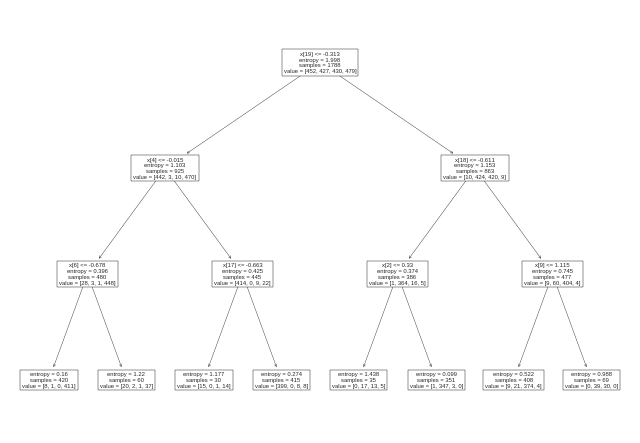

In [165]:
from sklearn import tree
#PLot the decision tree
tree.plot_tree(model_dt);

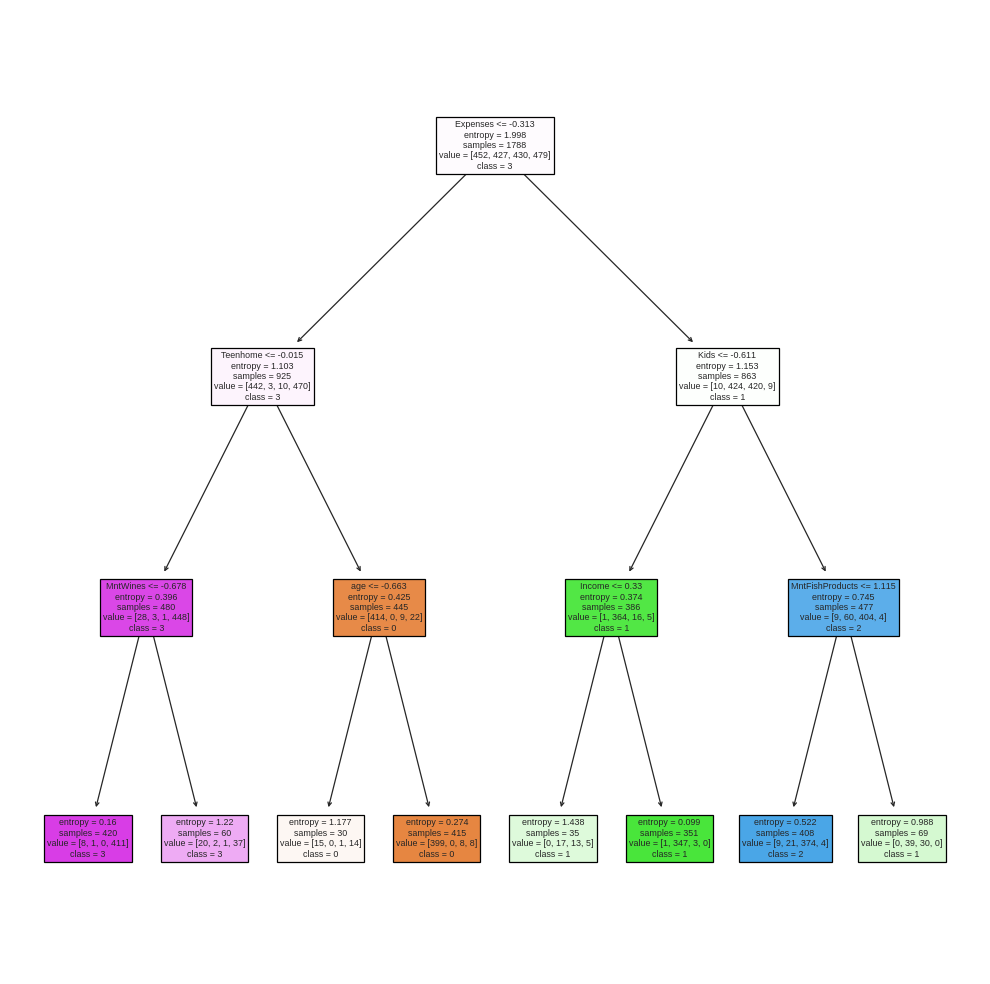

In [166]:
fn= data.columns
cn=['0', '1','2','3']
fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,4), dpi=300)
tree.plot_tree(model_dt,
               feature_names = fn,
               class_names=cn,
               filled = True);

In [167]:
#Predicting on test data
rescaledxtest = scaler_dt.transform(x_test)
pred_dt = model_dt.predict(rescaledxtest) # predicting on test data set
pd.Series(pred_dt).value_counts() # getting the count of each category

1    138
3    112
0    108
2     90
Name: count, dtype: int64

In [168]:
from sklearn.metrics import confusion_matrix,accuracy_score
cm_dt = confusion_matrix(y_test,pred_dt)
acc_dt = accuracy_score(y_test,pred_dt)
print(cm_dt)
print(acc_dt)

[[ 98   0   2  11]
 [  0 121   4   0]
 [  5  17  82   1]
 [  5   0   2 100]]
0.8950892857142857


In [169]:
#display classification report
from sklearn.metrics import classification_report
print(classification_report(y_test,pred_dt))

              precision    recall  f1-score   support

           0       0.91      0.88      0.89       111
           1       0.88      0.97      0.92       125
           2       0.91      0.78      0.84       105
           3       0.89      0.93      0.91       107

    accuracy                           0.90       448
   macro avg       0.90      0.89      0.89       448
weighted avg       0.90      0.90      0.89       448



# Building Decision Tree Classifier (CART) using Gini Criteria

In [170]:
model_dt_gini = DecisionTreeClassifier(criterion='gini', max_depth=3)

In [171]:
model_dt_gini.fit(rescaledx, y_train)

DecisionTreeClassifier(max_depth=3)

In [172]:
#Predicting on test data
pred_dt_gini = model_dt_gini.predict(rescaledxtest) # predicting on test data set
pd.Series(pred_dt_gini).value_counts() # getting the count of each category

1    118
3    112
2    110
0    108
Name: count, dtype: int64

In [173]:
from sklearn.metrics import confusion_matrix,accuracy_score
cm_gini = confusion_matrix(y_test,pred_dt_gini)
acc_gini = accuracy_score(y_test,pred_dt_gini)
print(cm_gini)
print(acc_gini)

[[ 98   0   2  11]
 [  0 109  16   0]
 [  5   9  90   1]
 [  5   0   2 100]]
0.8861607142857143


In [174]:
print(classification_report(y_test,pred_dt_gini))

              precision    recall  f1-score   support

           0       0.91      0.88      0.89       111
           1       0.92      0.87      0.90       125
           2       0.82      0.86      0.84       105
           3       0.89      0.93      0.91       107

    accuracy                           0.89       448
   macro avg       0.89      0.89      0.89       448
weighted avg       0.89      0.89      0.89       448



## Random Forest


In [175]:
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier

In [176]:
# Random Forest Classification

from sklearn.ensemble import RandomForestClassifier


num_trees = 100
max_features = 3
kfold = KFold(n_splits=10, random_state=None)
model_rf = RandomForestClassifier(n_estimators=num_trees, max_features=max_features)
results_rf = cross_val_score(model_rf, rescaledx,y_train, cv=kfold)
print(results_rf.mean())

0.9468708806729019


In [177]:
pred_rf = model_rf.fit(rescaledx,y_train).predict(rescaledxtest)

In [178]:
cm_rf = confusion_matrix(y_test,pred_rf)
acc_rf = accuracy_score(y_test,pred_rf)
print(cm_rf)
print(acc_rf)

[[104   0   2   5]
 [  0 116   9   0]
 [  3   2 100   0]
 [  3   0   2 102]]
0.9419642857142857


In [179]:
print(classification_report(y_test,pred_rf))

              precision    recall  f1-score   support

           0       0.95      0.94      0.94       111
           1       0.98      0.93      0.95       125
           2       0.88      0.95      0.92       105
           3       0.95      0.95      0.95       107

    accuracy                           0.94       448
   macro avg       0.94      0.94      0.94       448
weighted avg       0.94      0.94      0.94       448



## SVM

In [180]:
from sklearn.svm import SVC
classifier_svm = SVC(kernel = 'linear',random_state = 0)
classifier_svm.fit(rescaledx,y_train)

SVC(kernel='linear', random_state=0)

In [181]:
pred_svm = classifier_svm.predict(rescaledxtest)

In [182]:
cm_svm = confusion_matrix(y_test,pred_svm)
acc_svm = accuracy_score(y_test,pred_svm)
print(cm_svm)
print(acc_svm)

[[108   0   1   2]
 [  0 124   1   0]
 [  1   1 103   0]
 [  1   1   0 105]]
0.9821428571428571


In [183]:
print(classification_report(y_test,pred_svm))

              precision    recall  f1-score   support

           0       0.98      0.97      0.98       111
           1       0.98      0.99      0.99       125
           2       0.98      0.98      0.98       105
           3       0.98      0.98      0.98       107

    accuracy                           0.98       448
   macro avg       0.98      0.98      0.98       448
weighted avg       0.98      0.98      0.98       448



## Naive Bayes

In [184]:
from sklearn.naive_bayes import GaussianNB
classifier_nb = GaussianNB()
classifier_nb.fit(rescaledx,y_train)

GaussianNB()

In [185]:
pred_nb = classifier_nb.predict(rescaledxtest)

In [186]:
cm_nb = confusion_matrix(y_test,pred_nb)
acc_nb = accuracy_score(y_test,pred_nb)
print(cm_nb)
print(acc_nb)

[[102   0   6   3]
 [  0 116   9   0]
 [  0   1 104   0]
 [ 10   1   3  93]]
0.9263392857142857


In [187]:
print(classification_report(y_test,pred_nb))

              precision    recall  f1-score   support

           0       0.91      0.92      0.91       111
           1       0.98      0.93      0.95       125
           2       0.85      0.99      0.92       105
           3       0.97      0.87      0.92       107

    accuracy                           0.93       448
   macro avg       0.93      0.93      0.93       448
weighted avg       0.93      0.93      0.93       448



## K NEAREST NEIGHBOURS

In [188]:
from sklearn.neighbors import KNeighborsClassifier
model_knn = KNeighborsClassifier(n_neighbors=2)
cv_knn = cross_val_score(model_knn,rescaledx,y_train,cv=kfold)

In [189]:
print(cv_knn)
print('mean:',cv_knn.mean()*100)

[0.89944134 0.92178771 0.90502793 0.94413408 0.91620112 0.88268156
 0.91061453 0.94972067 0.89325843 0.89325843]
mean: 91.16125792480071


In [190]:
pred_knn = model_knn.fit(rescaledx,y_train).predict(rescaledxtest)

In [191]:
cm_knn = confusion_matrix(y_test,pred_knn)
acc_knn = accuracy_score(y_test,pred_knn)
print(cm_knn)
print(acc_knn)

[[104   0   3   4]
 [  0 121   4   0]
 [ 17   7  80   1]
 [  9   1   1  96]]
0.8950892857142857


In [192]:
print(classification_report(y_test,pred_knn))

              precision    recall  f1-score   support

           0       0.80      0.94      0.86       111
           1       0.94      0.97      0.95       125
           2       0.91      0.76      0.83       105
           3       0.95      0.90      0.92       107

    accuracy                           0.90       448
   macro avg       0.90      0.89      0.89       448
weighted avg       0.90      0.90      0.89       448



## COMPARING THE ACCURACIES OF THE  MODELS

In [193]:

accu = pd.DataFrame({
    'Model': ['Decision Tree(Entropy)','Decision Tree(Gini)', 'Random Forest', 'SVM', 'Naive Bayes', 'KNN'],
    'Accuracy': [acc_dt.mean() * 100, acc_gini.mean() * 100, acc_rf.mean() * 100, acc_svm * 100, acc_nb * 100, acc_knn * 100]
})


accuracy = accu.sort_values(by='Accuracy', ascending=False)


print(accuracy)

                    Model   Accuracy
3                     SVM  98.214286
2           Random Forest  94.196429
4             Naive Bayes  92.633929
0  Decision Tree(Entropy)  89.508929
5                     KNN  89.508929
1     Decision Tree(Gini)  88.616071


## SVM has the highest accuracy

## DEPLOYMENT

In [196]:
feature_names = ['Income','Kids','age','Marital_Status','Education']
target = 'Clusters'

In [197]:
# Split data into training and testing sets
x1_train, x2_test, y1_train, y2_test = train_test_split(data[feature_names], data[target], test_size=0.2, random_state=42)

In [198]:
scaler_svm1 = StandardScaler().fit(x1_train)
rescaledx1 = scaler_svm1.transform(x1_train)

In [199]:
model_svm1 = SVC(kernel = 'linear',random_state = 0)
model_svm1.fit(rescaledx1,y1_train)

SVC(kernel='linear', random_state=0)

In [200]:
rescaledx2test = scaler_svm1.transform(x2_test)
pred_rf1 = model_svm1.fit(rescaledx1,y1_train).predict(rescaledx2test)

In [201]:
cm_rf1 = confusion_matrix(y2_test,pred_rf1)
acc_rf1 = accuracy_score(y2_test,pred_rf1)
print(cm_rf1)
print(acc_rf1)

[[ 79   1  20  16]
 [  1  98  16   3]
 [ 15   2  72   7]
 [  8   0   4 106]]
0.7924107142857143


In [202]:
print(classification_report(y2_test,pred_rf1))

              precision    recall  f1-score   support

           0       0.77      0.68      0.72       116
           1       0.97      0.83      0.89       118
           2       0.64      0.75      0.69        96
           3       0.80      0.90      0.85       118

    accuracy                           0.79       448
   macro avg       0.80      0.79      0.79       448
weighted avg       0.80      0.79      0.79       448



In [203]:

# Ask the user to input each feature of the new data point
num_features = 5  # Change this to the number of features in your data
new_data_point_inputs = []
for i in range(num_features):
    feature_input = input(f"Enter feature {i+1}: ")
    new_data_point_inputs.append(float(feature_input.strip()))

# Convert the input values to a numpy array representing the new data point
new_data_point = np.array(new_data_point_inputs)

# Preprocess the new data point (scaling)
sc_new = StandardScaler()
new_data_point_scaled = sc_new.fit_transform(new_data_point.reshape(1, -1))

# Make predictions for the new data point
predic = model_svm1.predict(new_data_point_scaled)

# Print the prediction
print("Prediction for the new data point:", predic)

Enter feature 1: 67
Enter feature 2: 1
Enter feature 3: 0
Enter feature 4: 58000
Enter feature 5: 2
Prediction for the new data point: [2]


## Model Saving

In [204]:
import pickle
from pickle import dump
from pickle import load


In [205]:
#saving the model to disk
filename = 'SVM.sav'
dump(model_svm1 ,open( filename , 'wb'))

In [206]:
import pickle
from sklearn.svm import SVC



# Save the trained SVM model to a .pkl file
with open('SVM.pkl', 'wb') as f:
    pickle.dump(model_svm1, f)


In [207]:
from sklearn.preprocessing import StandardScaler

# Save the trained scaler to a .pkl file
with open('Scaler.pkl', 'wb') as f:
    pickle.dump(scaler_svm1, f)

In [208]:
!pip install streamlit

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 19.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 42.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.0 MB/s eta 0:00:00


In [209]:
import streamlit as st
import numpy as np
import pandas as pd
from sklearn.svm import SVC
import pickle
from sklearn.preprocessing import StandardScaler



# Function to predict using the saved model
def cluster(age, education, marital_status, income, kids):

    features = [[age, education, marital_status, income,kids]]
    model = pickle.load(open('SVM.pkl', 'rb'))
    prediction = model.predict(features)
    return prediction

st.set_page_config(page_title="Clustering")
st.title('Customer Clustering')
st.write('This app retuns a cluster id in which a customer may belong : ')

# Add input widgets for user input
col1, col2 = st.columns(2)
age = col1.slider('Age', min_value=18, max_value=100, value=30, step=1)

education = col2.radio('Education', ['UnderGraduate', 'Graduate', 'PostGraduate', 'PhD'])

marital_status = col2.radio( "Marital Status", ('Single', 'Married', 'Together', 'Others') )

income = col1.slider('Income', min_value=0, max_value=600000, value=50000, step=1000)


kids = int(col2.radio( "Select Number Of Kids In Household", ('0', '1','2','3') ))

# Map marital status and education to numerical values
marital_status_map = {'Single':0,'Married':1,'Together':2,'Others':3}
education_map = {'UnderGraduate':0,'Graduate':1, 'PostGraduate':2, 'PhD': 3}

marital_status = marital_status_map[marital_status]
education = education_map[education]


st.write(f'Your inputs were : {age, education, marital_status, income, kids}')

# Make a prediction and display the result
if st.button('Predict'):
    cluster_id = cluster(age, education, marital_status, income, kids)
    st.write('**Predicted Cluster id :**', cluster_id)

2024-04-05 11:57:55.329 
  command:

    streamlit run /usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py [ARGUMENTS]
